# GLMS -- SingleRFs 

In [1]:
import sys
import os
import h5py 

# setup paths
iteration = 1 # which version of this tutorial to run (in case want results in different dirs)
NBname = 'color_cloud_initial{}'.format(iteration)

myhost = os.uname()[1] # get name of machine
print("Running on Computer: [%s]" %myhost)

if myhost=='mt': # this is sigur
    sys.path.insert(0, '/home/jake/Repos/')
    dirname = os.path.join('.', 'checkpoints')
    datadir = '/home/dbutts/V1/Conway/'
else:
    sys.path.insert(0, '/home/felixbartsch/Code/') 
    datadir = '/Data/FelixData/Conway/'  
    dirname = '/home/felixbartsch/Data/Colorworkspace/' # Working directory 

import numpy as np
import scipy.io as sio
from copy import deepcopy

# plotting
import matplotlib.pyplot as plt

# Import torch
import torch
from torch import nn

# NDN tools
import NDNT.utils as utils # some other utilities
from NDNT.utils import imagesc   # because I'm lazy
from NDNT.utils import ss        # because I'm real lazy
import NDNT.NDNT as NDN
from NDNT.modules.layers import *
from NDNT.networks import *
from time import time
import dill
import ColorDataUtils.ConwayUtils as CU
import ColorDataUtils.RFutils as RU

from NTdatasets.generic import GenericDataset
import NTdatasets.conway.cloud_datasets as datasets
import NTdatasets.conway.bar1d_datasets as bardatasets

device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
device0 = torch.device("cpu")
dtype = torch.float32

# Where saved models and checkpoints go -- this is to be automated
print( 'Save_dir =', dirname)

%load_ext autoreload
%autoreload 2
device

Running on Computer: [m1]
Invoking __init__.py for NDNT.utils
Save_dir = /home/felixbartsch/Data/Colorworkspace/


device(type='cuda', index=0)

In [2]:
fndate= '0711'
#local data structs

#data directory structs
PROOT = 'J22'+fndate
fn = PROOT+'_CC_CC'
fn0 = fn+'_v08'

datadir2 = datadir+'proc/'+PROOT+'/'
analdir = datadir2+'analysis/'
moddir = datadir2+'models/'

In [3]:
# Load BINOCULAR only (single RFs)
# Load data
UNX = 60
num_lags = 10

inclMUs = True
t0 = time()
data = datasets.ColorClouds(
    filenames=[fn0], eye_config=3, drift_interval=16,
    datadir=datadir2, folded_lags=False, luminance_only=False,
    trial_sample=True, num_lags=num_lags, 
    include_MUs=inclMUs)

t1 = time()
print(t1-t0, 'sec elapsed')

NT = data.NT #len(data.fix_n)
NA = data.Xdrift.shape[1]
print("%d (%d valid) time points"%(NT, len(data)))
#data.valid_inds = np.arange(NT, dtype=np.int64)

lam_units = np.where(data.channel_map < 32)[0]
ETunits = np.where(data.channel_map > 32)[0]
UTunits = np.where(data.channel_map >= 32+127)[0]
NFunits = np.where((data.channel_map > 32) & (data.channel_map < (32+128)))[0]
print( "%d laminar units, %d ET units"%(len(lam_units), len(ETunits)))

# # Replace DFs
matdat = sio.loadmat(datadir2+fn+'_DFupdate.mat')
data.dfs = torch.tensor( matdat['XDF'][:NT, :], dtype=torch.float32 )

# Pull correct saccades
matdat = sio.loadmat( datadir2+fn+'_ETupdate.mat')
data.process_fixations(matdat['sac_binsB'][0, :])

#sac_ts_all = matdat['ALLsac_bins'][0, :]
#data.process_fixations( sac_ts_all )

#    'tsacs_msB': Bsac_ts,  ## microsaccade times in seconds (4 sec trials)
#    'sac_bins_allB': Bsacbins_all, # bin numbers of sac sampled at 60 Hz
#    'sac_amps_allB': CampsB, ## squared magnitude
#    'sac_ampsB': Bsac_amps, # reduced sac times & amplitude given threshold
#    'sac_binsB': Bsac_bins,
#    'sac_tsB': Bsac_ts,
#    'et60HzB': ETprocB, # downsampled processed eye trace
#    'et1kHzB': et1khzB,

Loading data into memory...
Adjusting stimulus read from disk: mean | std = 0.000 | 0.269
T-range: 0 154320
  Trimming experiment 254160->154320 time points based on eye_config and Tmax
105.10017585754395 sec elapsed
154320 (154320 valid) time points
17 laminar units, 147 ET units
  Redoing fix_n with saccade inputs: 5443 saccades


In [4]:
# Segregate 'valid' Utah units
Reff = torch.mul(data.robs[:, UTunits], data.dfs[:, UTunits]).numpy()
nspks = np.sum(Reff, axis=0)
a = np.where(nspks > 10)[0]
valUT = UTunits[a]
NCUT = len(valUT)

Reff = torch.mul(data.robs[:, NFunits], data.dfs[:, NFunits]).numpy()
nspks = np.sum(Reff, axis=0)
a = np.where(nspks > 10)[0]
valNF = NFunits[a]
NCNF = len(valNF)

Reff = torch.mul(data.robs[:, ETunits], data.dfs[:, ETunits]).numpy()
nspks = np.sum(Reff, axis=0)
a = np.where(nspks > 100)[0]
valET = ETunits[a]
NCv_ET = len(valET)

Reff = torch.mul(data.robs[:, lam_units], data.dfs[:, lam_units]).numpy()
nspks = np.sum(Reff, axis=0)
a = np.where(nspks > 10)[0]
valLP = lam_units[a]
NCL = len(valLP)

print( "%d out of %d Laminar units kept"%(NCL, len(lam_units)) )
print( "%d out of %d NF units kept"%(NCNF, len(NFunits)) )
print( "%d out of %d Utah units kept"%(NCUT, len(UTunits)) )

10 out of 17 Laminar units kept
7 out of 7 NF units kept
126 out of 140 Utah units kept


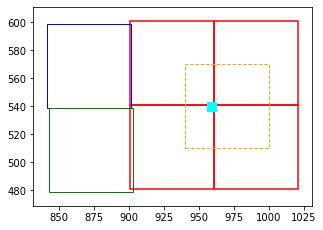

In [5]:
#Ready:
#top_corner = np.array([970, 500], dtype=np.int64) #for 0729 - dataset bork?

#TODO (or redo) with ET clouds:
top_corner = np.array([940, 510], dtype=np.int64) #for 0711

#top_corner = np.array([965, 535], dtype=np.int64) #for 0628
#top_corner = np.array([940, 515], dtype=np.int64) #for 0715 - All meas done
#top_corner = np.array([950, 530], dtype=np.int64) #for 0718 - LP meas done; ET done
#top_corner = np.array([990, 540], dtype=np.int64) #for 0722 - LP meas done; ET done
#top_corner = np.array([995, 550], dtype=np.int64) #for 0727 - LP meas done
#top_corner = np.array([990, 550], dtype=np.int64) #for 0801 - LP meas done; ET needs redoing
#top_corner = np.array([980, 550], dtype=np.int64) #for 0808 - LP meas done
# 0909
#top_corner = np.array([1015, 540], dtype=np.int64) #for 1007 - LP meas done


#TODO with new 1Dbar-compatible loading:
#for 0207
#for 0217
#for 0304
#top_corner = np.array([966, 535], dtype=np.int64) #for 0314
#for 0316
#for 0318
#top_corner = np.array([966, 530], dtype=np.int64) #for 0320 - LP meas done
#for 0321
# 0616
#top_corner = np.array([955, 525], dtype=np.int64) #for 0621 - LP meas done (1D ET)

#DONE with 60 pix:
#top_corner = np.array([955, 520], dtype=np.int64) #for 0921
#top_corner = np.array([990, 515], dtype=np.int64) #for 1003
#top_corner = np.array([1005, 530], dtype=np.int64) #for 0926 - also has shifted RFcenters
#top_corner = np.array([975, 550], dtype=np.int64) #for 0803
#top_corner = np.array([965, 540], dtype=np.int64) #for 0805
#top_corner = np.array([940, 515], dtype=np.int64) #for 0701
#top_corner = np.array([955, 520], dtype=np.int64) #for 0705
#top_corner = np.array([950, 525], dtype=np.int64) #for 0707
#top_corner = np.array([945, 525], dtype=np.int64) #for 0713
#top_corner = np.array([980, 530], dtype=np.int64) #for 0720
#top_corner = np.array([990, 540], dtype=np.int64) #for 0725


data.draw_stim_locations(top_corner = top_corner, L=60)

In [6]:
#data.assemble_stimulus(which_stim='lam', stim_wrap = [30, -25], fixdot=0 ) #, stim_crop=[0,49,5,54])

data.assemble_stimulus(top_corner=top_corner, fixdot=0, L=60 )

  Writing lam stim 0: overlap 21, 31
  Writing lam stim 1: overlap 21, 29
  Writing lam stim 2: overlap 39, 29
  Writing lam stim 3: overlap 39, 31
  Adding fixation point
  Done


In [7]:
# LP STAs
Reff = torch.mul(data.robs[:, valLP], data.dfs[:, valLP])
nspks = torch.sum(Reff, axis=0)
lag = 4
#stas0 = ((data.stim[:-lag, ...].T @ Reff[lag:,:]).squeeze() / nspks).reshape([60,60,-1]).numpy()
stas0 = ((data.stim[:-lag, ...].T @ Reff[lag:,:]).squeeze() / nspks).reshape([3,60,60,-1]).numpy()

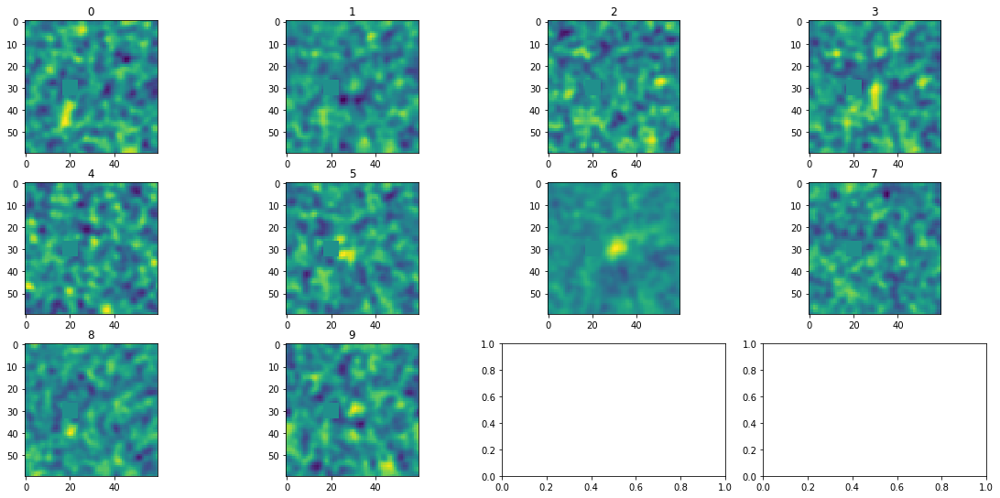

In [8]:
NCv = len(valLP)
Nrows=int(np.ceil(NCv/4))
ss(Nrows,4)
for cc in range(NCv):
    plt.subplot(Nrows,4, cc+1)
    imagesc(stas0[0,:,:, cc])
    plt.title(str(cc))
plt.show()

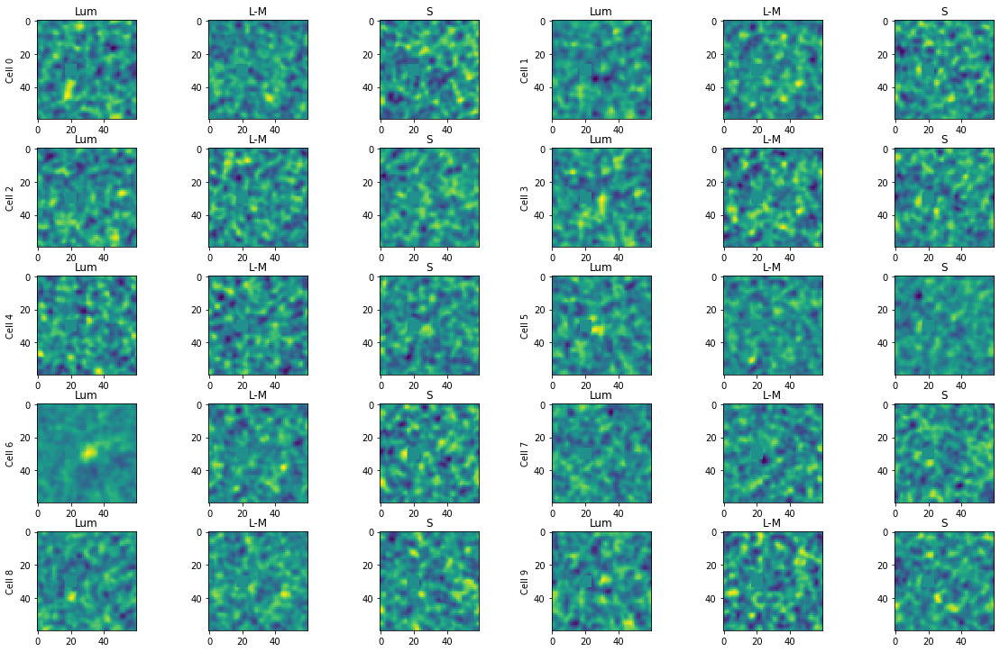

In [9]:
ctext = ['Lum', 'L-M', 'S']
Nrows=int(np.ceil(NCv/2))
ss(Nrows, 6, rh=2)
for cc in range(NCv):
    for clr in range(3):
        plt.subplot(Nrows, 6, 3*cc+clr+1)
        imagesc(stas0[clr, :, :, cc])
        if clr == 0:
            plt.ylabel( "Cell %d"%cc)
        plt.title(ctext[clr])

## GLMs

In [10]:
shifts = np.array([[0,0], [0, 0], [0, 0]]) # if not caring about non-LP things
NXglm = UNX

LLs0, LLsGLM, XTopt, GLopt = np.zeros([NCv,2]), np.zeros(NCv), np.zeros(NCv), np.zeros(NCv)
glms = [None]*NCv
driftmods = [None]*NCv
Dreg = 0.1

lbfgs_pars = utils.create_optimizer_params(
    optimizer_type='lbfgs',
    tolerance_change=1e-10,
    tolerance_grad=1e-10,
    batch_size=16000,
    max_epochs=3,
    max_iter = 200)
#lbfgs_pars['num_workers'] = 0

  Writing lam stim 0: overlap 21, 31
  Writing lam stim 1: overlap 21, 29
  Writing lam stim 2: overlap 39, 29
  Writing lam stim 3: overlap 39, 31
  Adding fixation point
  Done
Cell   0:  R10   LLs = -0.014892578125
Cell   0:  R6   LL =-0.01489 ->-0.00214


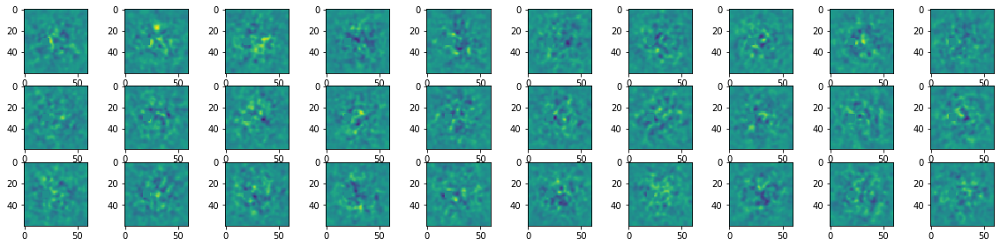

Cell   1:  R10   LLs = -0.004525184631347656
Cell   1:  R6   LL =-0.00453 -> 0.00099


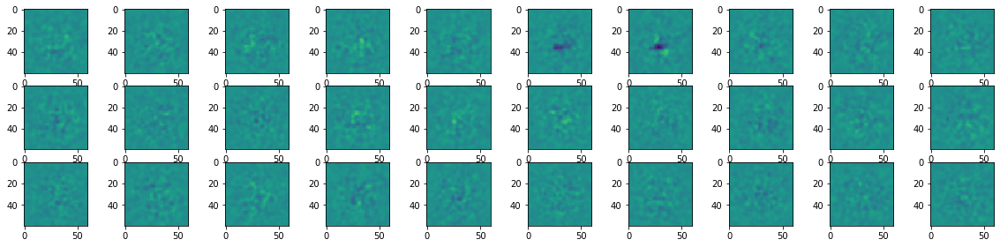

Cell   2:  R10   LLs = -0.01363372802734375
Cell   2:  R6   LL =-0.01363 ->-0.00346


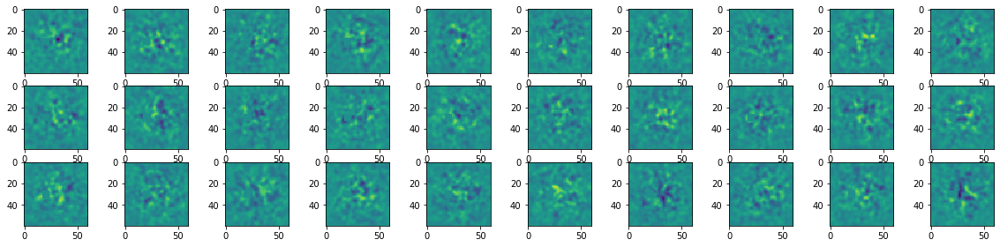

Cell   3:  R10   LLs = -0.003308594226837158
Cell   3:  R6   LL =-0.00331 -> 0.00005


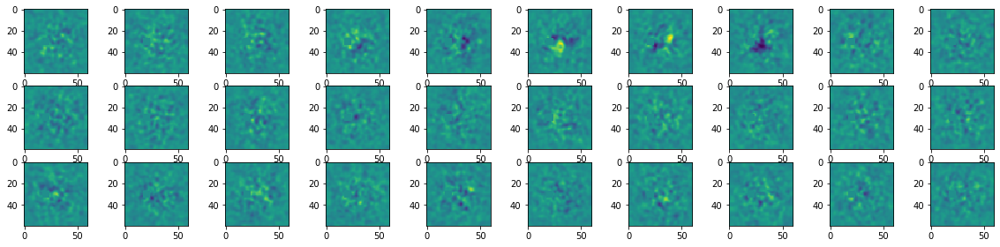

Cell   4:  R10   LLs = -0.009602069854736328
Cell   4:  R6   LL =-0.00960 -> 0.00017


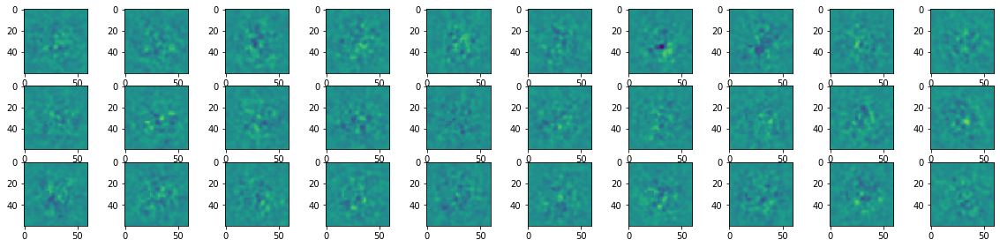

Cell   5:  R10   LLs = 0.00018262863159179688
Cell   5:  R5   LL = 0.00018 -> 0.00233


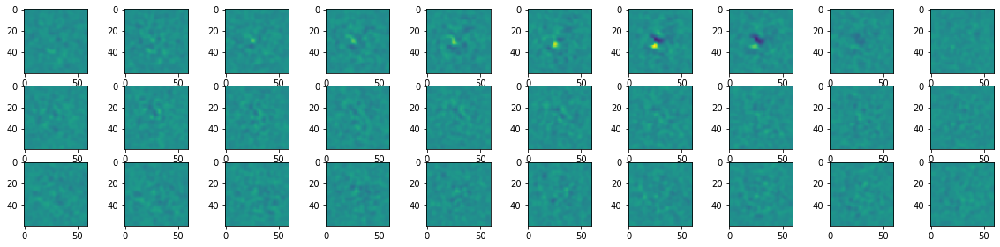

Cell   6:  R9   LLs = 0.02066868543624878
Cell   6:  R3   LL = 0.02067 -> 0.02128


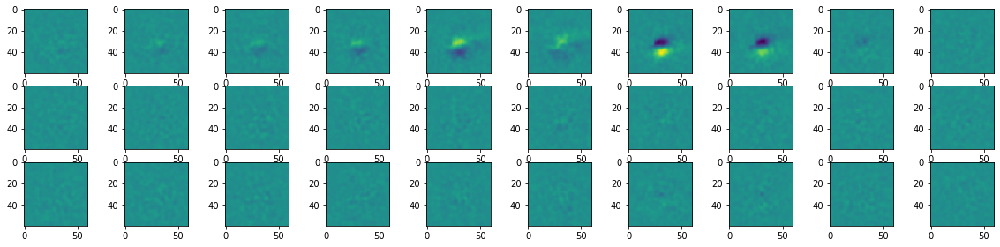

Cell   7:  R10   LLs = -0.012348651885986328
Cell   7:  R6   LL =-0.01235 -> 0.00054


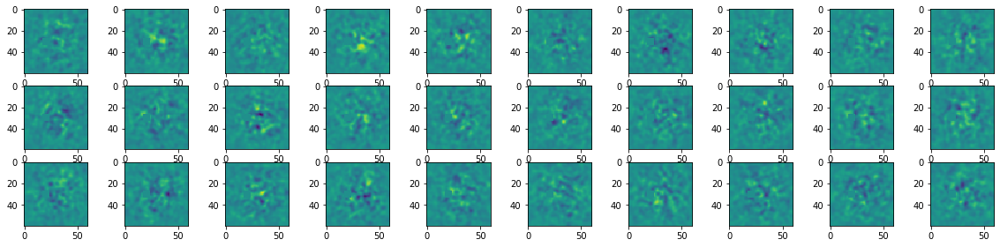

Cell   8:  R10   LLs = -0.007379293441772461
Cell   8:  R6   LL =-0.00738 ->-0.00011


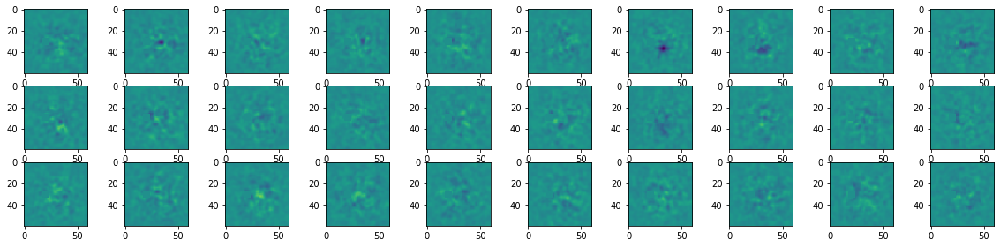

Cell   9:  R10   LLs = -0.003760814666748047
Cell   9:  R6   LL =-0.00376 -> 0.00078


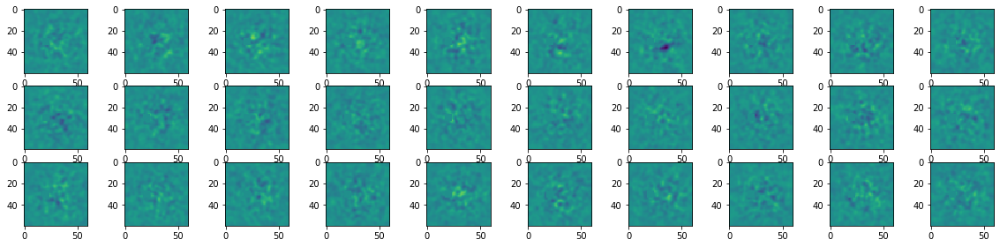

In [11]:
XTreg = 20 # [20]
L1reg = 0.5 # [0.5]
GLreg = 4.0 # [4.0]

glm_layer = Tlayer.layer_dict( 
    input_dims=[3,NXglm,NXglm,1], num_filters=1, bias=False, num_lags=num_lags,
    NLtype='lin', initialize_center = True)
glm_layer['reg_vals'] = {'d2xt': XTreg, 'l1': L1reg, 'glocalx': GLreg,'edge_t':100} 

stim_net =  FFnetwork.ffnet_dict( xstim_n = 'stim', layer_list = [glm_layer] )

drift_pars1 = NDNLayer.layer_dict( 
    input_dims=[1,1,1,NA], num_filters=1, bias=False, norm_type=0, NLtype='lin')
drift_pars1['reg_vals'] = {'d2t': Dreg, 'bcs':{'d2t':0} } 

# for stand-alone drift model
drift_pars1N = deepcopy(drift_pars1)
drift_pars1N['NLtype'] = 'softplus'

drift_net =  FFnetwork.ffnet_dict( xstim_n = 'Xdrift', layer_list = [drift_pars1] )

comb_layer = NDNLayer.layer_dict(
    num_filters = 1, NLtype='softplus', bias=False)
comb_layer['weights_initializer'] = 'ones'

net_comb = FFnetwork.ffnet_dict( 
    xstim_n = None, ffnet_n=[0,1],
    layer_list = [comb_layer], ffnet_type='add')

#stim_net['layer_list'][0]['reg_vals']['d2xt'] = 10
net_comb['layer_list'][0]['bias'] = True

glms = [None]*NCv
driftmods = [None]*NCv

XTopt = np.zeros(NCv) 
GLopt = np.zeros(NCv) 
LLsNULL = np.zeros(NCv)
LLsR = np.zeros([NCv,4])

rvals = [0.01, 0.1, 1, 10, 30, 100, 300, 500, 1000, 3000, 10000]
rvalsG = [1, 3, 10, 30, 100, 300, 1000] # glocal


data.assemble_stimulus(top_corner=top_corner, fixdot=0, L=NXglm, time_embed=0, num_lags=num_lags )

for cc in range(NCv):
    data.cells_out = [valLP[cc]]

    drift_iter = NDN.NDN( 
        layer_list = [drift_pars1N], loss_type='poisson')
    drift_iter.block_sample=True
    drift_iter.networks[0].xstim_n = 'Xdrift'
    drift_iter.fit( data, force_dict_training=True, train_inds=None, **lbfgs_pars, verbose=0, version=1)
    LLsNULL[cc] = drift_iter.eval_models(data[data.val_blks], null_adjusted=False)[0]
    driftmods[cc] = deepcopy(drift_iter)

    LLs = np.zeros(len(rvals))+LLsR[cc,0]
    LLs = np.zeros(len(rvals))+LLsNULL[cc]
    for rr in range(len(rvals)):
        #glm_layer['reg_vals']['d2xt'] = rvals[rr]
        #stim_net =  FFnetwork.ffnet_dict( xstim_n = 'stim', layer_list = [glm_layer] )

        stim_net['layer_list'][0]['reg_vals']['d2xt'] = rvals[rr]
        glm_iter = NDN.NDN(  
            ffnet_list = [stim_net, drift_net, net_comb], loss_type='poisson')
        glm_iter.block_sample=True
        glm_iter.networks[1].layers[0].weight.data[:,0] = deepcopy(
            driftmods[cc].networks[0].layers[0].weight.data[:,0])
        glm_iter.networks[2].layers[0].set_parameters(val=False,name='weight')
        glm_iter.networks[1].layers[0].set_parameters(val=False)

        glm_iter.fit( data, force_dict_training=True, **lbfgs_pars, seed=None, version=9, verbose=0)
        LLi = glm_iter.eval_models(data[data.val_blks], null_adjusted=False)[0]
        if (rr == 0) or (LLi < np.min(LLs)):
            best_model = deepcopy(glm_iter)
        LLs[rr] = LLi

    bm = np.argmin(LLs)

    LLsR[cc,0] = LLs[bm]
    XTopt[cc] = rvals[bm]
    print( "Cell %3d:  R%d   LLs ="%(cc, bm), LLsNULL[cc]-LLsR[cc,0] )
    bm = np.argmin(LLs)
    XTopt[cc] = rvals[bm]
    glms[cc] = deepcopy(best_model)

    LLs = np.zeros(len(rvalsG))+LLsR[cc,0]
    for rr in range(len(rvalsG)):
        glm_iter = deepcopy(best_model)
        glm_iter.networks[0].layers[0].reg.vals['glocalx'] = rvals[rr]
        glm_iter.fit( data, force_dict_training=True, **lbfgs_pars, seed=5, version=9, verbose=0)
        LLi = glm_iter.eval_models(data[data.val_blks], null_adjusted=False)[0]
        if (rr == 0) or (LLi < np.min(LLs)):
            best_model = deepcopy(glm_iter)
        LLs[rr] = LLi

    bm = np.argmin(LLs)
    LLsR[cc,1] = LLs[bm]
    GLopt[cc] = rvals[bm]
    glms[cc] = deepcopy(best_model)
    print( "Cell %3d:  R%d   LL =%8.5f ->%8.5f"%(cc, bm, LLsNULL[cc]-LLsR[cc,0], LLsNULL[cc]-LLsR[cc,1]) )
    
    w = best_model.get_weights()
    utils.subplot_setup(1,num_lags, row_height=4)
    for ll in range(num_lags):
        plt.subplot(3,num_lags,ll+1)
        utils.imagesc(w[0,:,:,ll,0], aspect=1, max=np.max(np.abs(w)))
        plt.subplot(3,num_lags,ll+1+num_lags)
        utils.imagesc(w[1,:,:,ll,0], aspect=1, max=np.max(np.abs(w)))
        plt.subplot(3,num_lags,ll+1+num_lags*2)
        utils.imagesc(w[2,:,:,ll,0], aspect=1, max=np.max(np.abs(w)))
    plt.show()

In [12]:
# Assemble population drift terms
w0 = driftmods[0].get_weights()
NA = w0.shape[0]
drift_terms = np.zeros([NA, NCv])
for cc in range(NCv):
    drift_terms[:, cc] = deepcopy(driftmods[cc].get_weights())[:,0]

# Assemble drift population model
drift_pars_pop = NDNLayer.layer_dict( 
    input_dims=[1,1,1,NA], num_filters=NCv, bias=False, norm_type=0, NLtype='softplus')
drift_pars_pop['reg_vals'] = {'d2t': Dreg, 'bcs':{'d2t':0} } 
drift_pop = NDN.NDN( layer_list = [drift_pars_pop], loss_type='poisson')
drift_pop.block_sample=True
drift_pop.networks[0].xstim_n = 'Xdrift'
drift_pop.networks[0].layers[0].weight.data = torch.tensor(drift_terms, dtype=torch.float32)
data.cells_out = list(valLP)
LLsCHECK = drift_pop.eval_models(data[data.val_blks], null_adjusted=False) 
print(np.mean(LLsNULL), np.mean(LLsCHECK))

2.6011446714401245 2.6011443


In [13]:
k = glms[cc].get_weights()
pfilt = np.std(k, axis=2).squeeze()

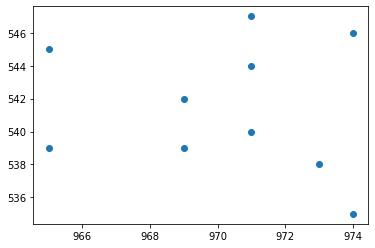

In [14]:
# Get array centers
RFcenters = np.zeros([NCv,2], dtype=np.int64) - 1
for cc in range(NCv):
    k = glms[cc].get_weights()
    pfilt = np.sum(np.std(k, axis=3),axis=0).squeeze() # for colorRFs
    # pfilt = np.std(k, axis=2).squeeze() # for lum RFs
    x,y = utils.max_multiD( pfilt ) 
    RFcenters[cc, :] = [x,y]
    
RFcenters[:,0] = RFcenters[:,0] + top_corner[0]
RFcenters[:,1] = RFcenters[:,1] + top_corner[1]
plt.plot(RFcenters[:, 0], RFcenters[:, 1],'o')
plt.show()

In [16]:
LLsGLM = LLsNULL-LLsR[:,1]
#dirname2 = dirname+'0715/' #moved up for convenience
sio.savemat(datadir2+PROOT+'_LP_GLM_info.mat', {
    'LLsNULL':LLsNULL[:,None], 'LLsGLM':LLsGLM[:, None], 'drift_terms': drift_terms, 'Dreg': Dreg,
    'RFcenters': RFcenters, 'top_corner': top_corner[:, None], 'valLP':valLP, 'NX': UNX})
sio.savemat(datadir2+PROOT+'_LP_stimpos.mat', {
    'LLsNULL':LLsNULL[:,None], 'LLsGLM':LLsGLM[:, None], 'drift_terms': drift_terms, 'Dreg': Dreg,
    'RFcenters': RFcenters, 'top_corner': top_corner[:, None], 'valLP':valLP, 'NX': UNX, 'source':'glms'})

drift_pop.save_model(filename=moddir+'LP_drift_pop.pkl')
for cc in range(NCv):
    glms[cc].save_model(
        filename=moddir+'LPglm' + utils.filename_num2str(cc, num_digits=3) + 'iter0.pkl')

  Saving model at /Data/FelixData/Conway/proc/J220711/models/LP_drift_pop.pkl
  Saving model at /Data/FelixData/Conway/proc/J220711/models/LPglm000iter0.pkl
  Saving model at /Data/FelixData/Conway/proc/J220711/models/LPglm001iter0.pkl
  Saving model at /Data/FelixData/Conway/proc/J220711/models/LPglm002iter0.pkl
  Saving model at /Data/FelixData/Conway/proc/J220711/models/LPglm003iter0.pkl
  Saving model at /Data/FelixData/Conway/proc/J220711/models/LPglm004iter0.pkl
  Saving model at /Data/FelixData/Conway/proc/J220711/models/LPglm005iter0.pkl
  Saving model at /Data/FelixData/Conway/proc/J220711/models/LPglm006iter0.pkl
  Saving model at /Data/FelixData/Conway/proc/J220711/models/LPglm007iter0.pkl
  Saving model at /Data/FelixData/Conway/proc/J220711/models/LPglm008iter0.pkl
  Saving model at /Data/FelixData/Conway/proc/J220711/models/LPglm009iter0.pkl


### now get model measures


In [17]:
glm_ks = np.zeros([NCv, 3, NXglm, NXglm, num_lags]) 
for cc in range(NCv):
    glm_ks[cc,:,:,:,:] = glms[cc].get_weights().squeeze()
glm_ks.shape

(10, 3, 60, 60, 10)

In [18]:
sio.savemat(analdir+PROOT+'_LP_GLM_measures.mat', {
    'glm_ks':glm_ks, 'valLP':valLP, 'LLsGLM':LLsGLM[:, None], 'top_corner': top_corner,
    'RFcenters': RFcenters})

## Now fit Utah array models for ET purposes

  Writing lam stim 0: overlap 36, 26
  Writing lam stim 1: overlap 36, 34
  Writing lam stim 2: overlap 24, 34
  Writing lam stim 3: overlap 24, 26
  Adding fixation point
  Done


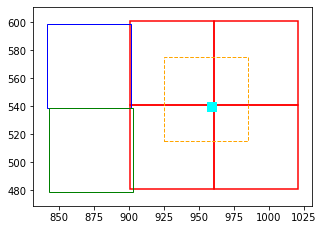

In [19]:
UTloc = np.array([925, 515], dtype=np.int64)

data.assemble_stimulus(top_corner=UTloc, fixdot=0, L=UNX, time_embed=0)
Reff = torch.mul(data.robs[:, valUT], data.dfs[:, valUT])
nspks = torch.sum(Reff, axis=0)

data.draw_stim_locations( top_corner=UTloc, L=UNX)

In [20]:
## Calculate STAS
lag = 4
stasC = ((data.stim[:-lag, ...].T @ Reff[lag:,:]).squeeze() / nspks).reshape([3, UNX,UNX,-1]).numpy()
stasC.shape

(3, 60, 60, 126)

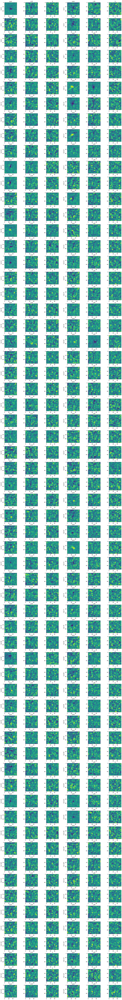

In [21]:
ctext = ['Lum', 'L-M', 'S']
Nrows=int(np.ceil(NCUT/2))
ss(Nrows, 6, rh=2)
for cc in range(NCUT):
    for clr in range(3):
        plt.subplot(Nrows, 6, 3*cc+clr+1)
        imagesc(stasC[clr, :, :, cc])
        if clr == 0:
            plt.ylabel( "Cell %d"%cc)
        plt.title(ctext[clr])

In [22]:
NCv=NCUT

NXglm = UNX
#num_lags = 10

LLs0, LLsGLM, XTopt, GLopt = np.zeros([NCv,2]), np.zeros(NCv), np.zeros(NCv), np.zeros(NCv)
glms = [None]*NCv
driftmods = [None]*NCv
Dreg = 0.1

lbfgs_pars = utils.create_optimizer_params(
    optimizer_type='lbfgs',
    tolerance_change=1e-10,
    tolerance_grad=1e-10,
    batch_size=16000,
    max_epochs=3,
    max_iter = 200)
#lbfgs_pars['num_workers'] = 0

  Writing lam stim 0: overlap 36, 26
  Writing lam stim 1: overlap 36, 34
  Writing lam stim 2: overlap 24, 34
  Writing lam stim 3: overlap 24, 26
  Adding fixation point
  Done
Cell   0:  R0   LLs = 0.018693923950195312
Cell   0:  R4   LL = 0.01869 -> 0.02296


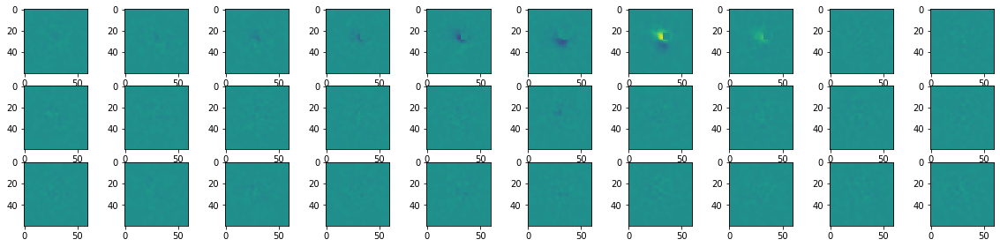

Cell   1:  R9   LLs = -0.0065991878509521484
Cell   1:  R6   LL =-0.00660 -> 0.00109


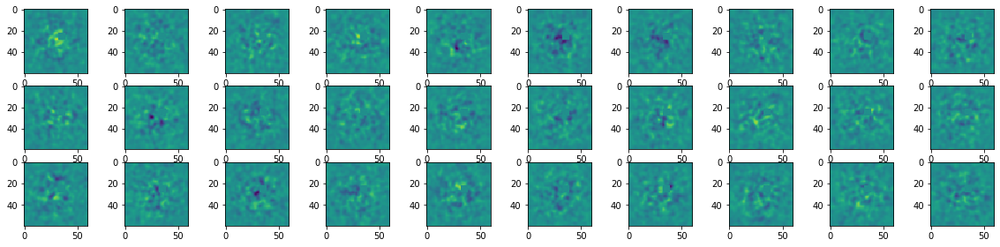

Cell   2:  R10   LLs = -0.0021191835403442383
Cell   2:  R6   LL =-0.00212 -> 0.00181


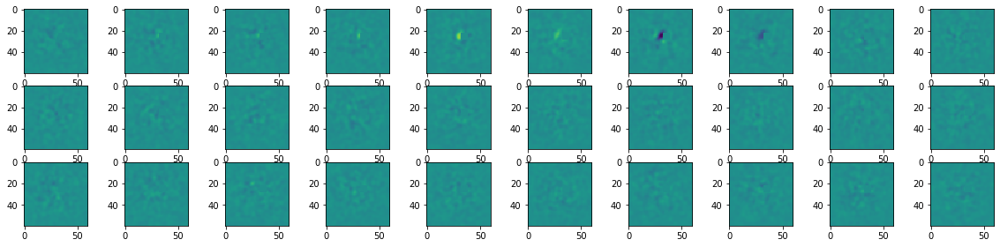

Cell   3:  R10   LLs = -0.0033216476440429688
Cell   3:  R6   LL =-0.00332 -> 0.00243


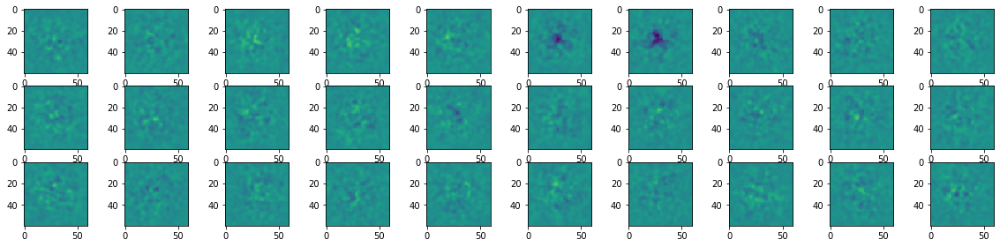

Cell   4:  R9   LLs = 0.02398967742919922
Cell   4:  R4   LL = 0.02399 -> 0.02595


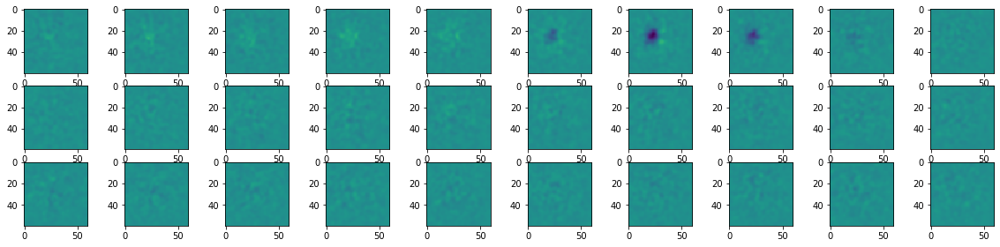

Cell   5:  R10   LLs = -0.012594223022460938
Cell   5:  R6   LL =-0.01259 ->-0.00115


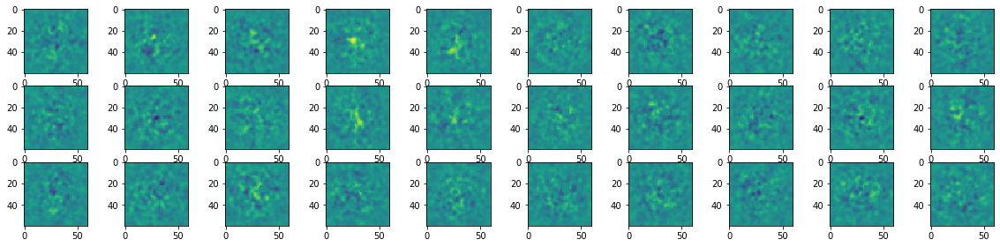

Cell   6:  R10   LLs = -0.006882667541503906
Cell   6:  R6   LL =-0.00688 ->-0.00129


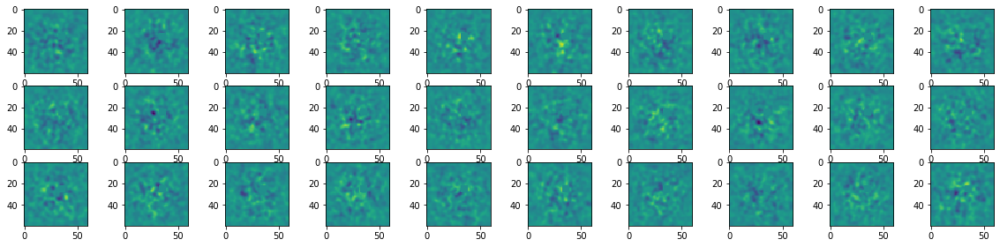

Cell   7:  R10   LLs = -0.003189563751220703
Cell   7:  R6   LL =-0.00319 -> 0.00186


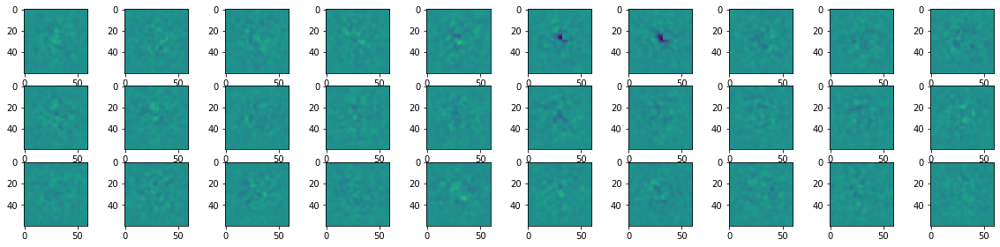

Cell   8:  R10   LLs = -0.006105899810791016
Cell   8:  R6   LL =-0.00611 ->-0.00006


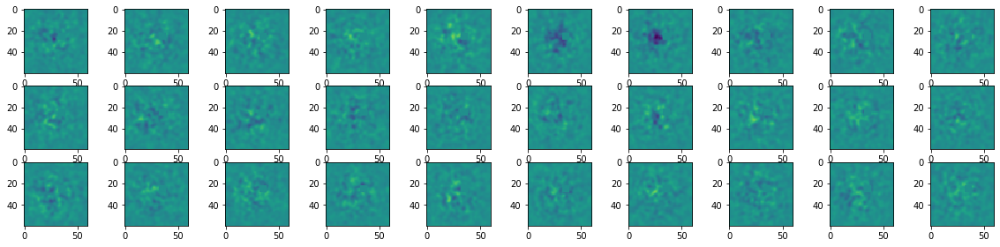

Cell   9:  R10   LLs = -0.010451555252075195
Cell   9:  R6   LL =-0.01045 ->-0.00216


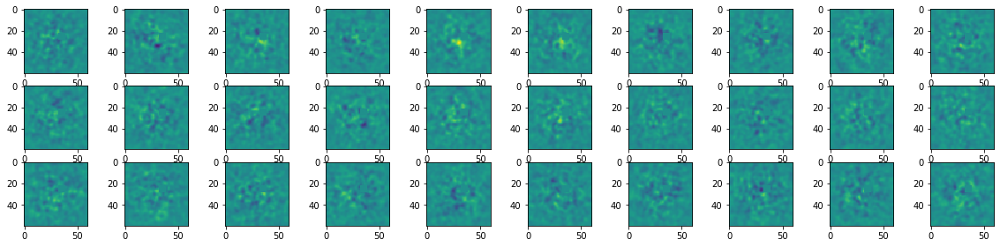

Cell  10:  R10   LLs = -0.0044062137603759766
Cell  10:  R6   LL =-0.00441 ->-0.00059


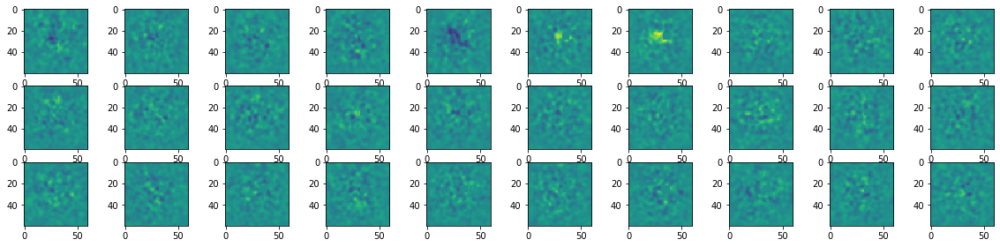

Cell  11:  R10   LLs = 0.018202781677246094
Cell  11:  R5   LL = 0.01820 -> 0.02327


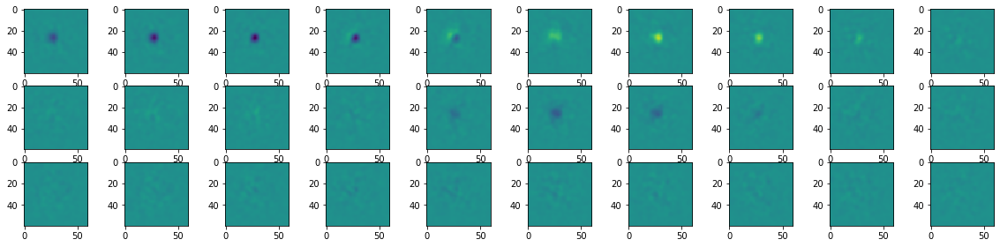

Cell  12:  R10   LLs = -0.0024313926696777344
Cell  12:  R6   LL =-0.00243 -> 0.00396


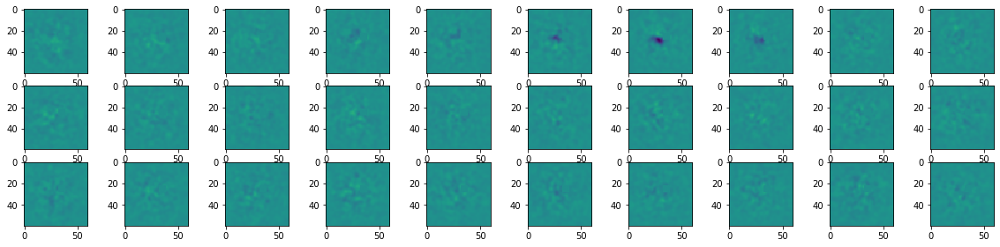

Cell  13:  R10   LLs = 0.0002579689025878906
Cell  13:  R5   LL = 0.00026 -> 0.00558


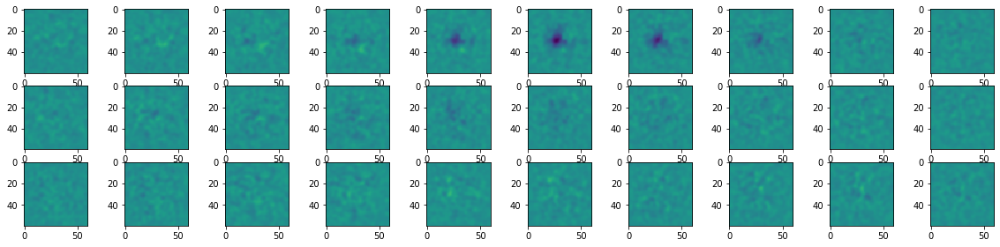

Cell  14:  R10   LLs = -0.007503986358642578
Cell  14:  R6   LL =-0.00750 ->-0.00149


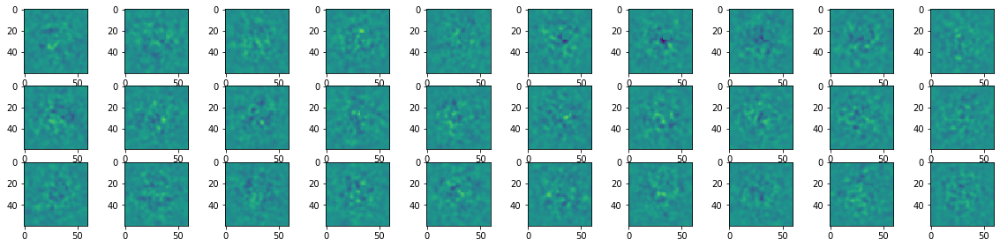

Cell  15:  R10   LLs = -0.002427816390991211
Cell  15:  R6   LL =-0.00243 -> 0.00319


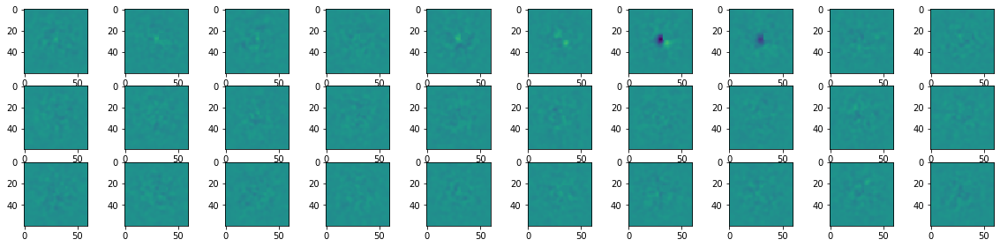

Cell  16:  R10   LLs = -0.005782365798950195
Cell  16:  R6   LL =-0.00578 -> 0.00045


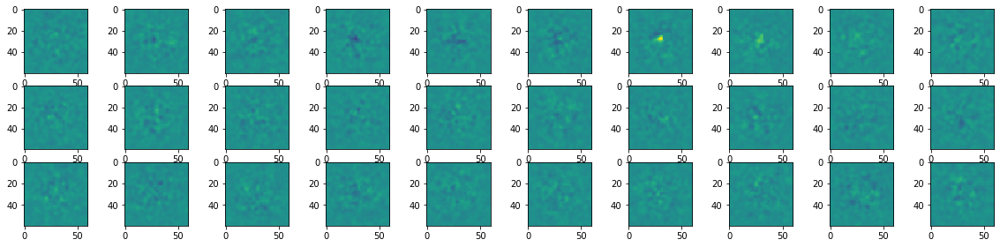

Cell  17:  R9   LLs = 0.03009200096130371
Cell  17:  R3   LL = 0.03009 -> 0.03109


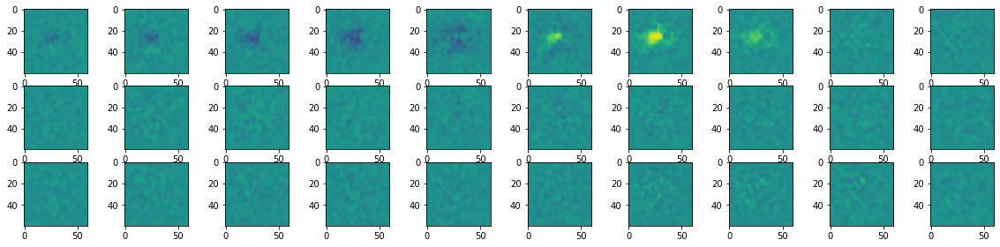

Cell  18:  R10   LLs = -0.003942728042602539
Cell  18:  R6   LL =-0.00394 -> 0.00015


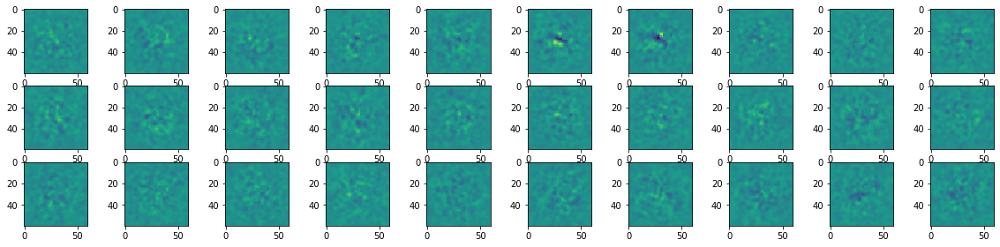

Cell  19:  R10   LLs = -0.006864786148071289
Cell  19:  R6   LL =-0.00686 -> 0.00111


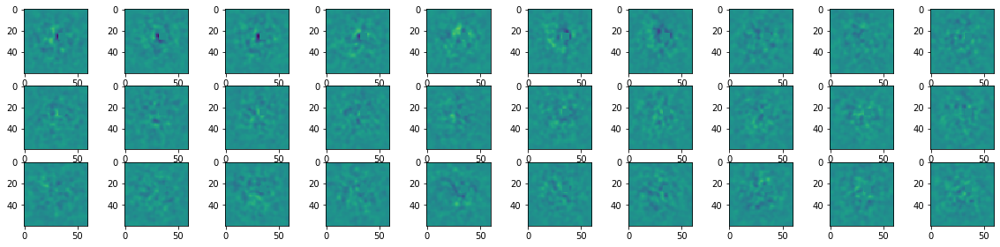

Cell  20:  R10   LLs = -0.002522706985473633
Cell  20:  R6   LL =-0.00252 -> 0.00359


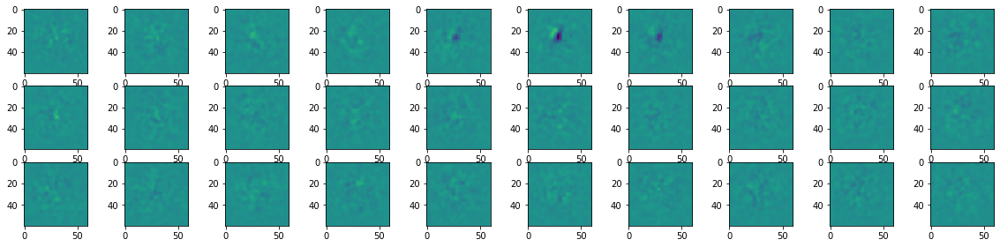

Cell  21:  R10   LLs = -0.007698535919189453
Cell  21:  R6   LL =-0.00770 ->-0.00154


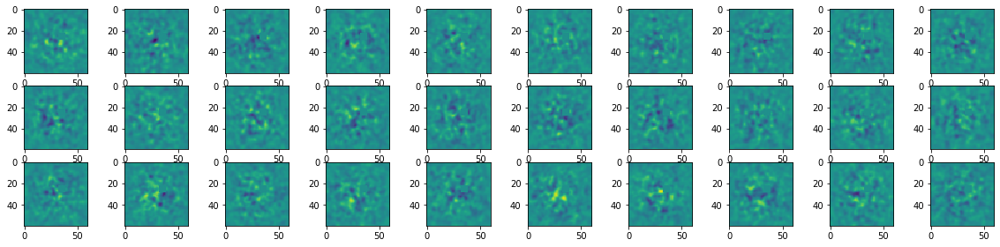

Cell  22:  R10   LLs = -0.00011396408081054688
Cell  22:  R6   LL =-0.00011 -> 0.00407


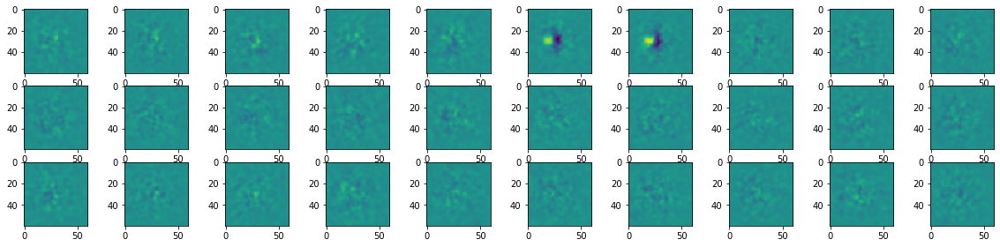

Cell  23:  R10   LLs = -0.008464336395263672
Cell  23:  R6   LL =-0.00846 ->-0.00237


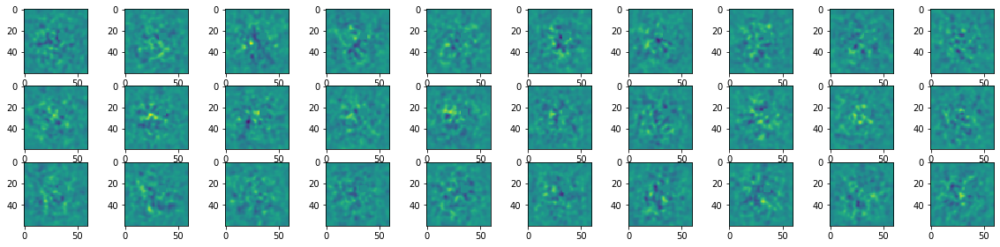

Cell  24:  R10   LLs = -0.007225632667541504
Cell  24:  R6   LL =-0.00723 ->-0.00044


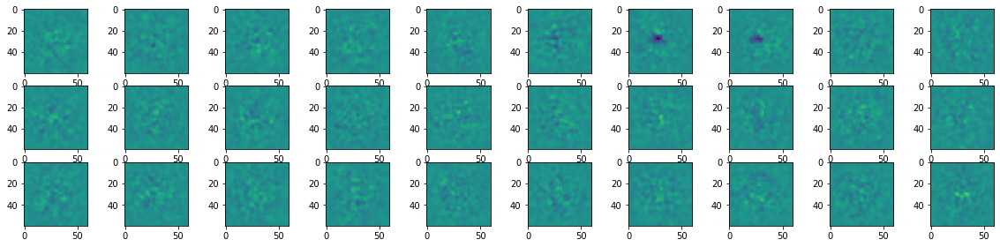

Cell  25:  R10   LLs = 0.001516580581665039
Cell  25:  R5   LL = 0.00152 -> 0.00610


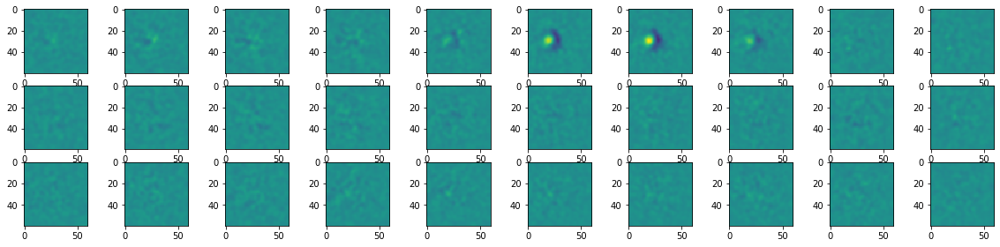

Cell  26:  R10   LLs = 0.004261016845703125
Cell  26:  R5   LL = 0.00426 -> 0.00769


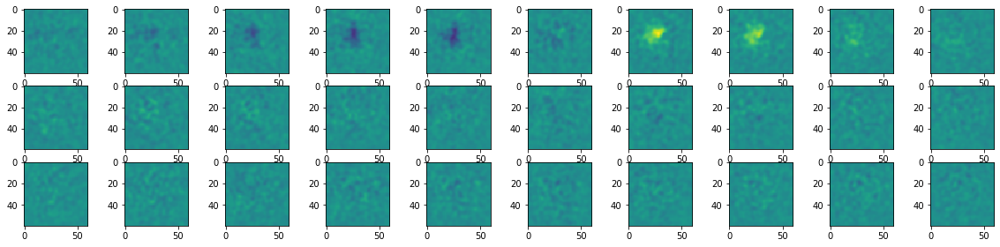

Cell  27:  R10   LLs = -0.004768013954162598
Cell  27:  R6   LL =-0.00477 -> 0.00052


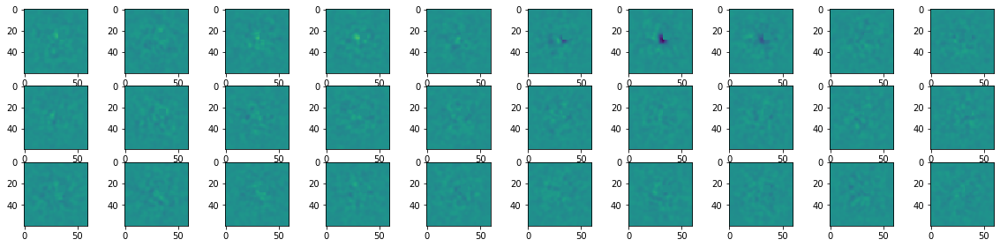

Cell  28:  R10   LLs = 0.005215644836425781
Cell  28:  R5   LL = 0.00522 -> 0.00977


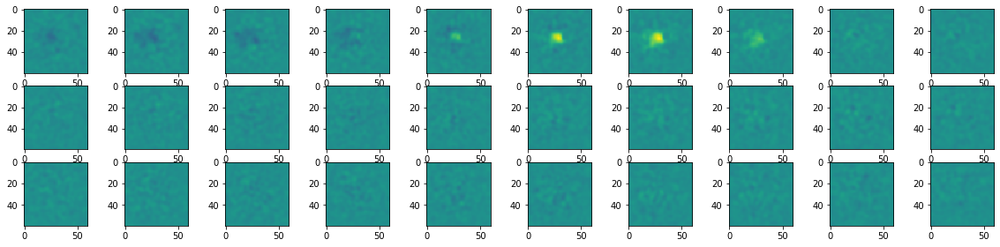

Cell  29:  R10   LLs = -0.006142616271972656
Cell  29:  R6   LL =-0.00614 -> 0.00075


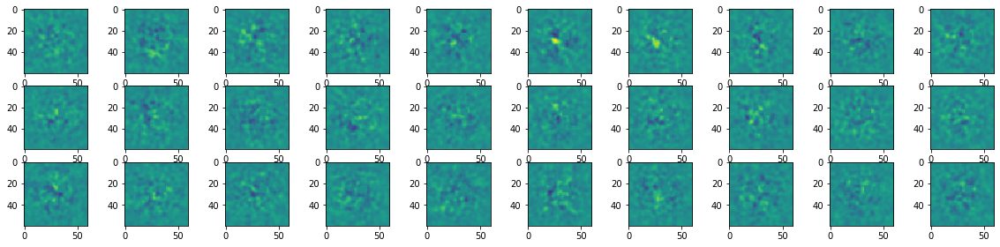

Cell  30:  R10   LLs = -0.007470607757568359
Cell  30:  R6   LL =-0.00747 ->-0.00046


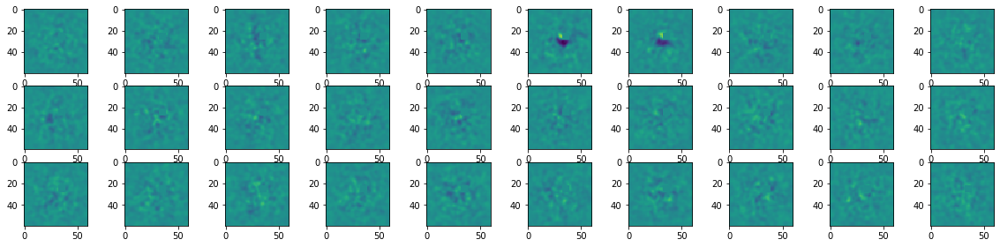

Cell  31:  R10   LLs = -0.004422903060913086
Cell  31:  R6   LL =-0.00442 ->-0.00087


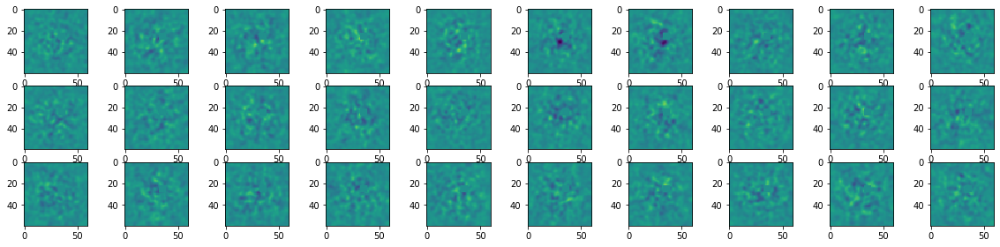

Cell  32:  R10   LLs = -0.0030515193939208984
Cell  32:  R6   LL =-0.00305 -> 0.00278


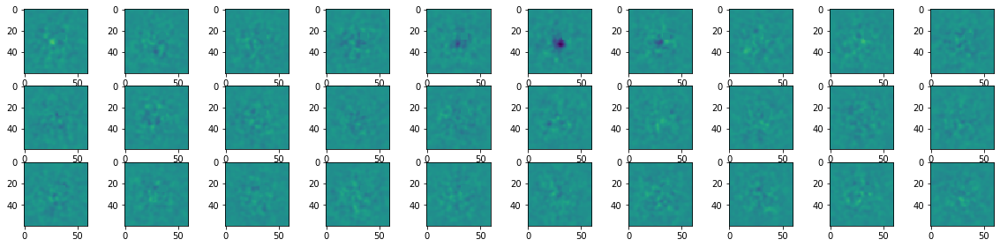

Cell  33:  R10   LLs = -0.008109807968139648
Cell  33:  R6   LL =-0.00811 ->-0.00045


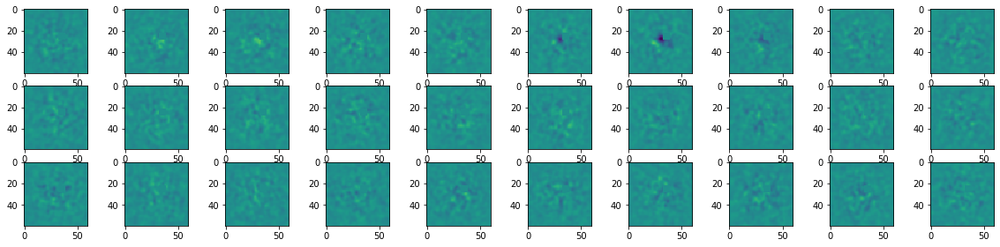

Cell  34:  R10   LLs = -0.003494739532470703
Cell  34:  R6   LL =-0.00349 -> 0.00191


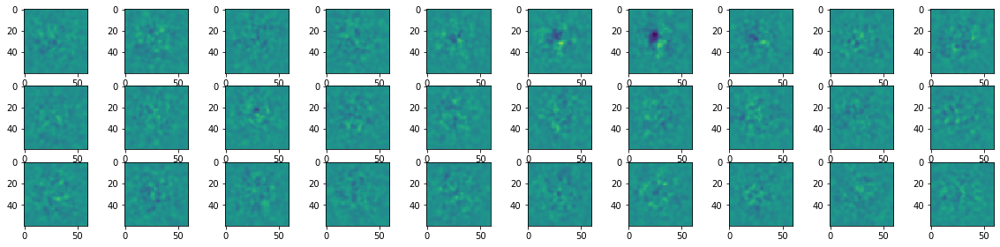

Cell  35:  R10   LLs = -0.0040503740310668945
Cell  35:  R6   LL =-0.00405 -> 0.00021


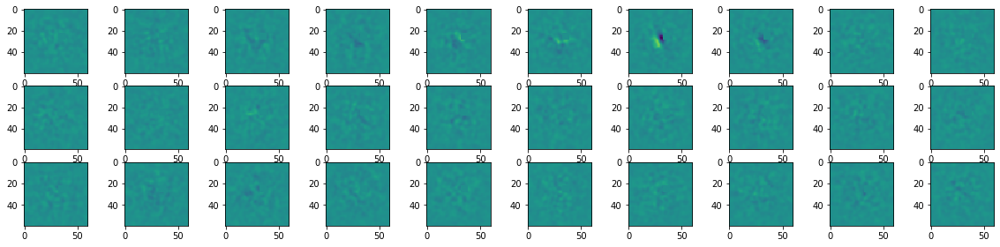

Cell  36:  R10   LLs = -0.006909012794494629
Cell  36:  R6   LL =-0.00691 ->-0.00077


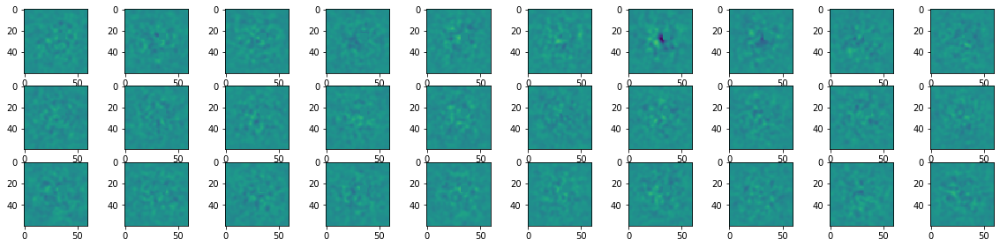

Cell  37:  R10   LLs = -0.003591775894165039
Cell  37:  R6   LL =-0.00359 -> 0.00047


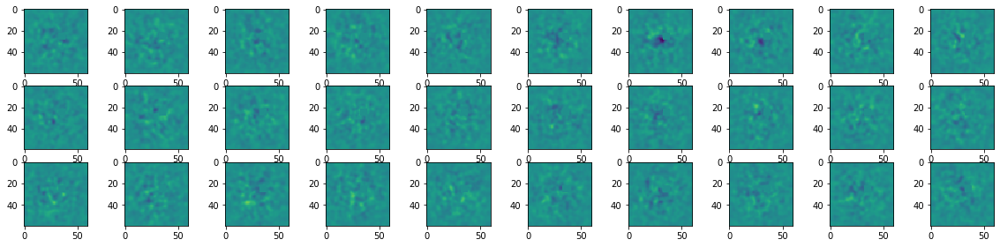

Cell  38:  R10   LLs = -0.005867719650268555
Cell  38:  R6   LL =-0.00587 -> 0.00052


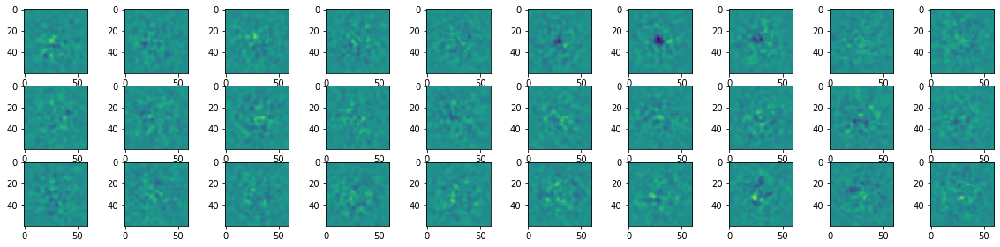

Cell  39:  R10   LLs = -0.007652759552001953
Cell  39:  R6   LL =-0.00765 ->-0.00024


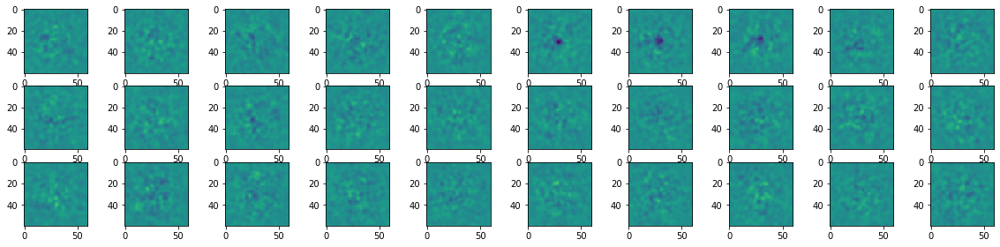

Cell  40:  R10   LLs = -0.005511283874511719
Cell  40:  R6   LL =-0.00551 ->-0.00015


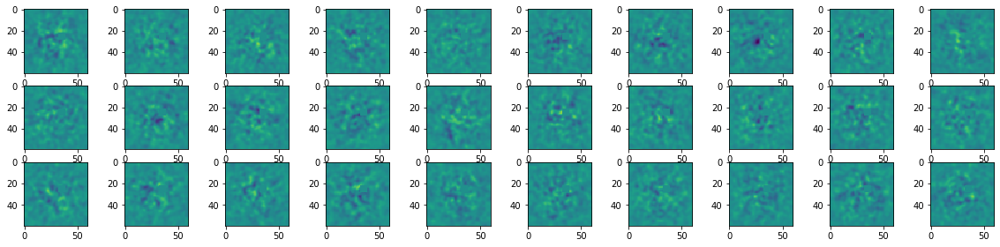

Cell  41:  R10   LLs = -0.010706901550292969
Cell  41:  R6   LL =-0.01071 ->-0.00238


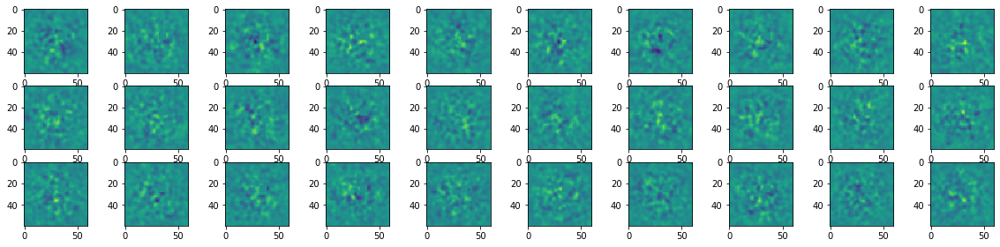

Cell  42:  R10   LLs = 0.002611875534057617
Cell  42:  R4   LL = 0.00261 -> 0.00503


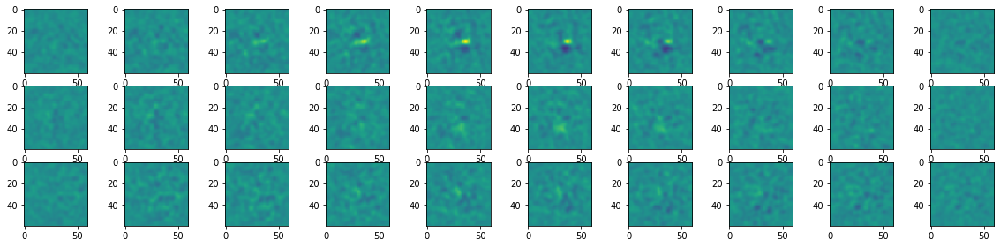

Cell  43:  R8   LLs = 0.009109973907470703
Cell  43:  R4   LL = 0.00911 -> 0.01210


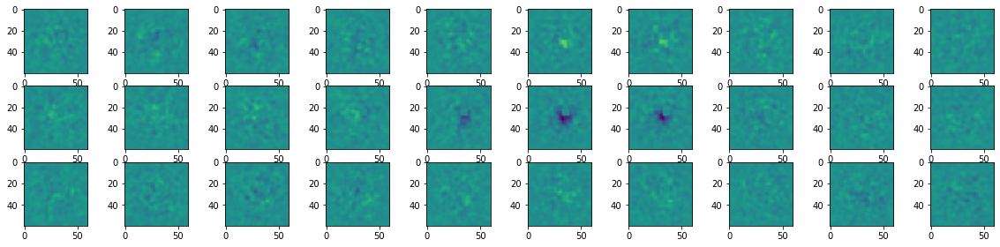

Cell  44:  R10   LLs = -0.006653547286987305
Cell  44:  R6   LL =-0.00665 ->-0.00121


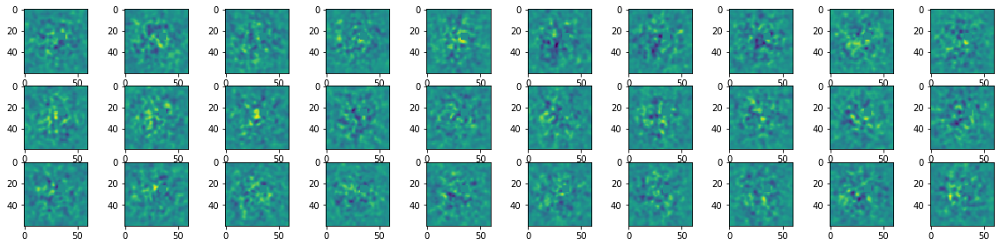

Cell  45:  R10   LLs = -0.003588438034057617
Cell  45:  R6   LL =-0.00359 ->-0.00007


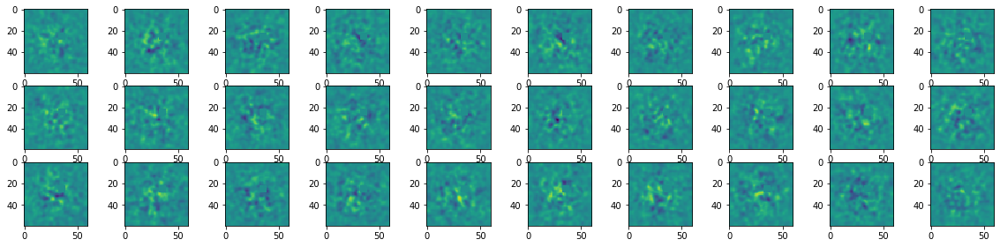

Cell  46:  R10   LLs = -0.003287672996520996
Cell  46:  R6   LL =-0.00329 ->-0.00021


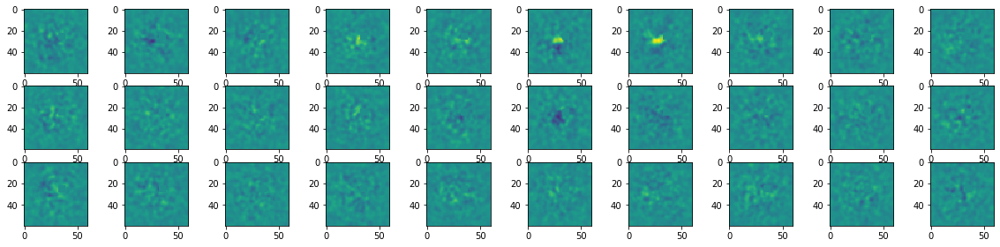

Cell  47:  R10   LLs = -0.00957179069519043
Cell  47:  R6   LL =-0.00957 ->-0.00176


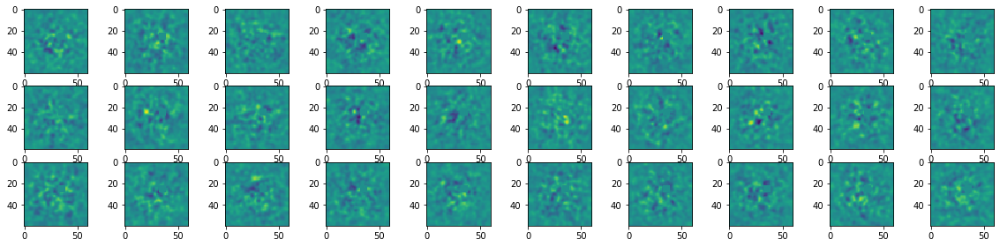

Cell  48:  R10   LLs = -0.006234169006347656
Cell  48:  R6   LL =-0.00623 ->-0.00059


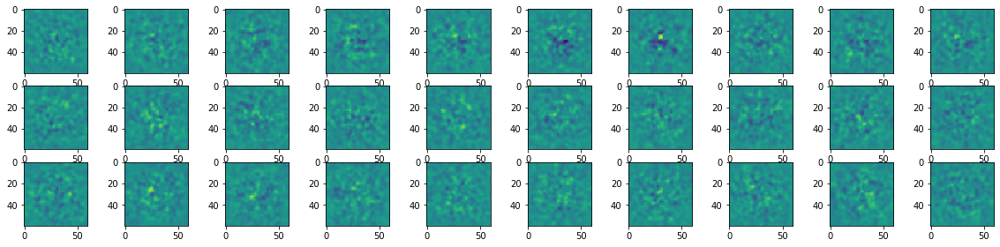

Cell  49:  R10   LLs = -0.0045206546783447266
Cell  49:  R6   LL =-0.00452 -> 0.00036


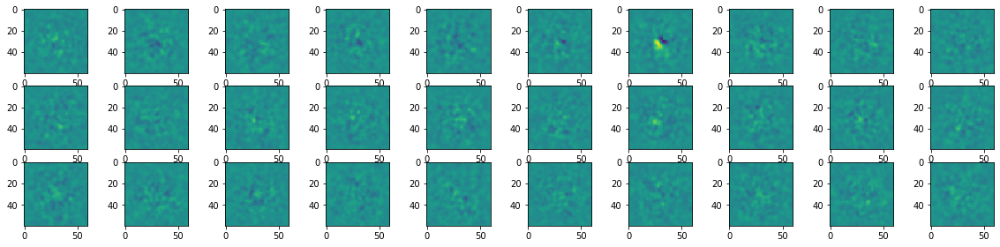

Cell  50:  R10   LLs = -0.01292276382446289
Cell  50:  R6   LL =-0.01292 ->-0.00188


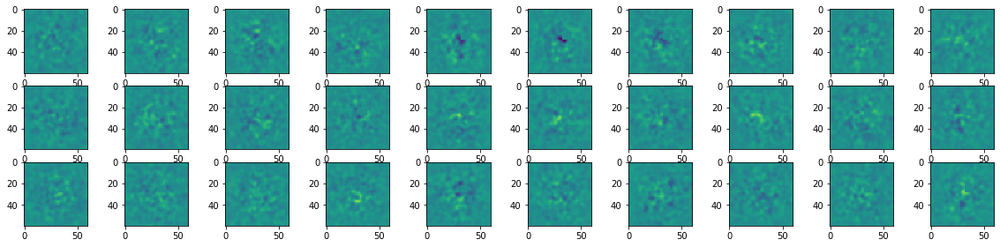

Cell  51:  R10   LLs = -0.012572526931762695
Cell  51:  R6   LL =-0.01257 ->-0.00131


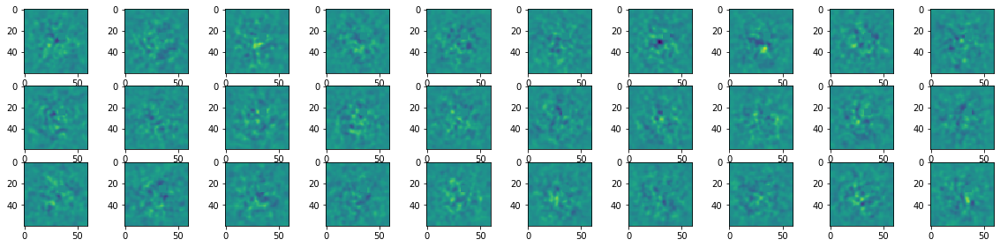

Cell  52:  R10   LLs = -0.012852191925048828
Cell  52:  R6   LL =-0.01285 ->-0.00154


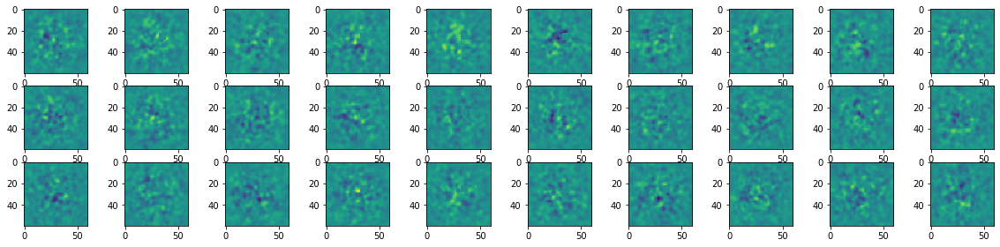

Cell  53:  R10   LLs = -0.012480497360229492
Cell  53:  R6   LL =-0.01248 ->-0.00339


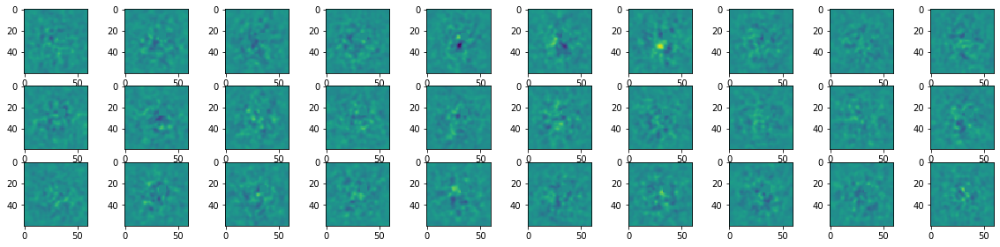

Cell  54:  R10   LLs = -0.011053323745727539
Cell  54:  R6   LL =-0.01105 ->-0.00256


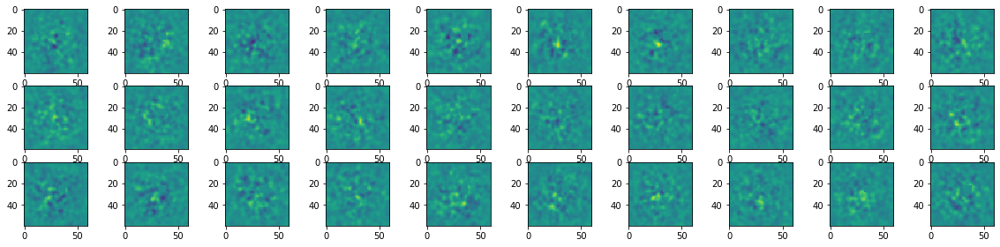

Cell  55:  R10   LLs = -0.010636091232299805
Cell  55:  R6   LL =-0.01064 ->-0.00198


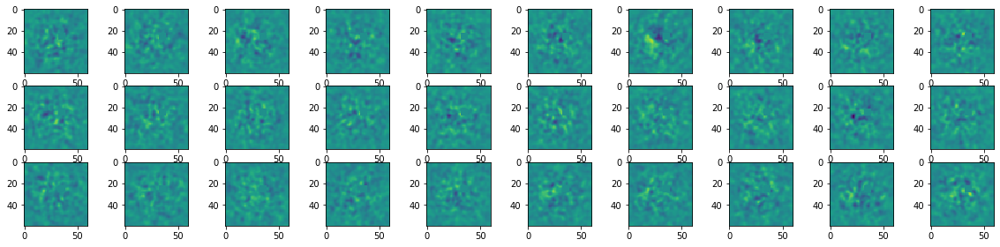

Cell  56:  R10   LLs = -0.009668111801147461
Cell  56:  R6   LL =-0.00967 ->-0.00164


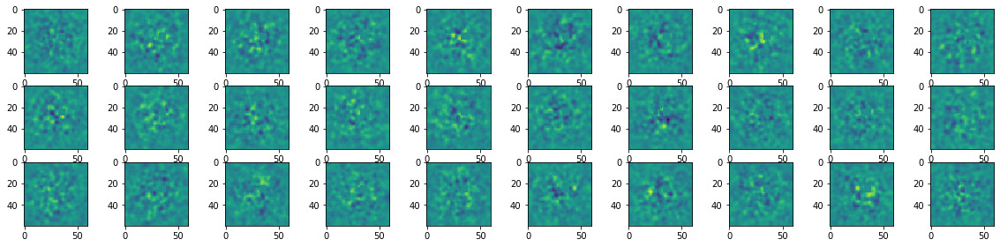

Cell  57:  R10   LLs = -0.01338648796081543
Cell  57:  R6   LL =-0.01339 ->-0.00267


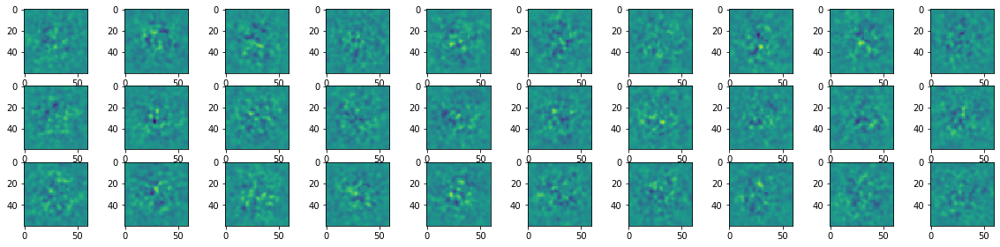

Cell  58:  R10   LLs = -0.0058422088623046875
Cell  58:  R6   LL =-0.00584 -> 0.00048


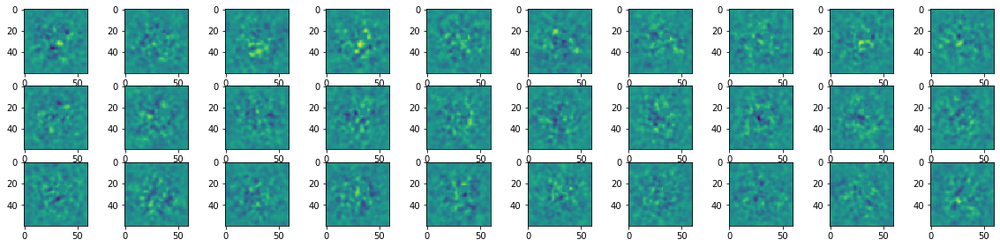

Cell  59:  R10   LLs = -0.005214691162109375
Cell  59:  R6   LL =-0.00521 ->-0.00034


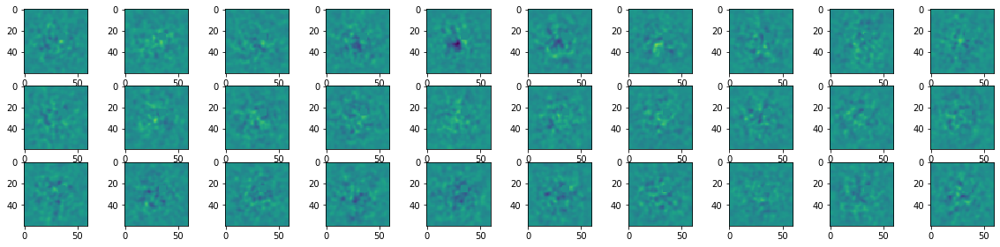

Cell  60:  R10   LLs = -0.0026543140411376953
Cell  60:  R6   LL =-0.00265 -> 0.00212


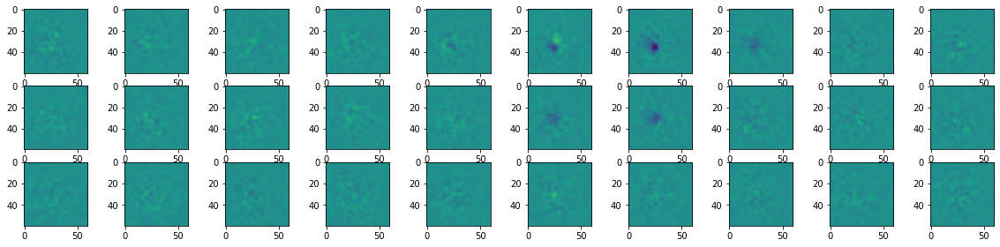

Cell  61:  R10   LLs = -0.004273891448974609
Cell  61:  R6   LL =-0.00427 -> 0.00085


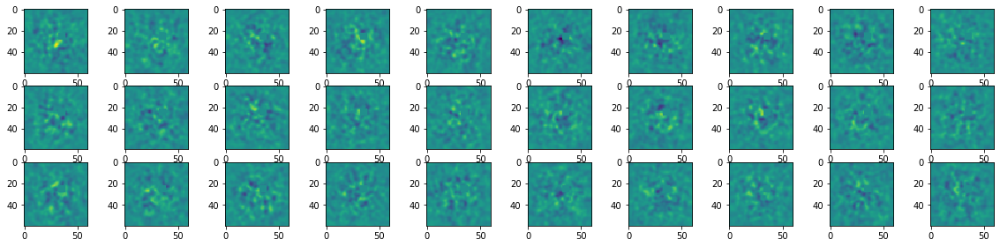

Cell  62:  R10   LLs = -0.010887861251831055
Cell  62:  R6   LL =-0.01089 ->-0.00267


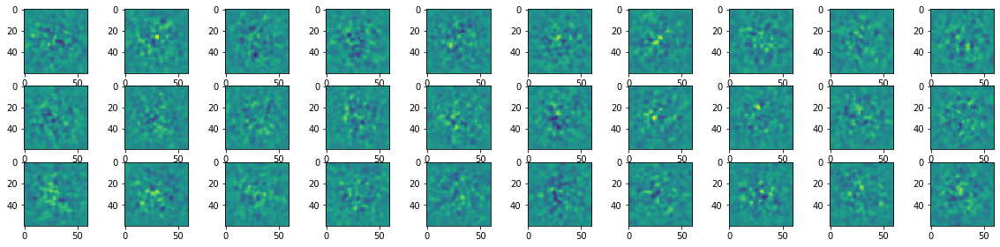

Cell  63:  R10   LLs = -0.004464149475097656
Cell  63:  R6   LL =-0.00446 -> 0.00024


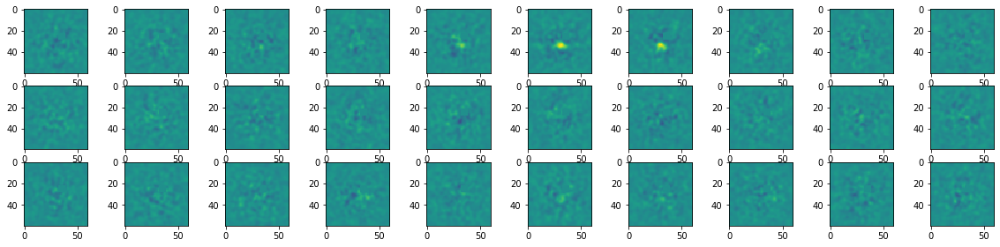

Cell  64:  R10   LLs = -0.01078343391418457
Cell  64:  R6   LL =-0.01078 ->-0.00164


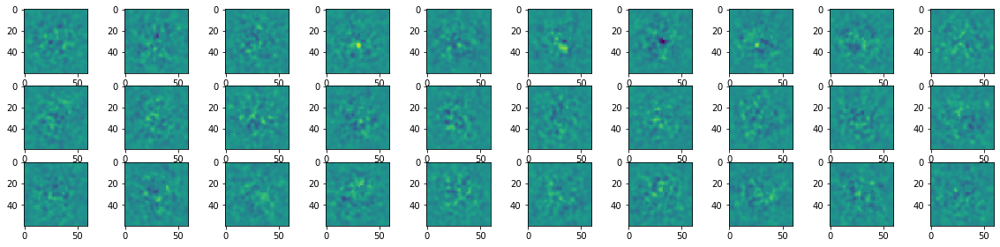

Cell  65:  R10   LLs = -0.0026224851608276367
Cell  65:  R6   LL =-0.00262 -> 0.00095


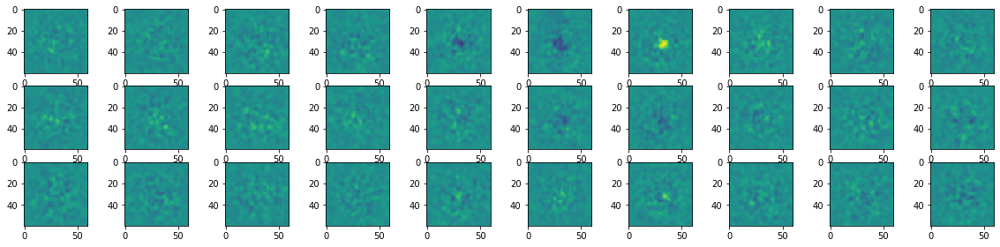

Cell  66:  R10   LLs = -0.0033223628997802734
Cell  66:  R6   LL =-0.00332 -> 0.00064


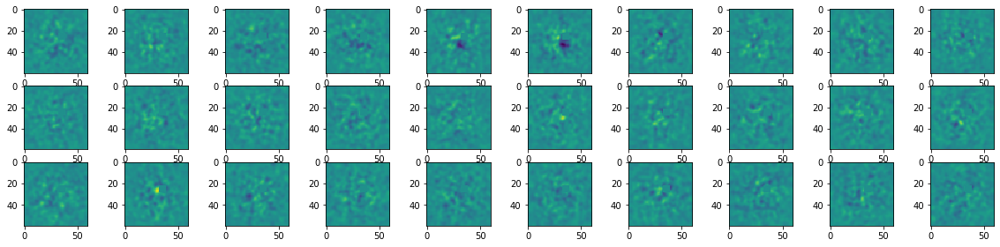

Cell  67:  R10   LLs = -0.004236936569213867
Cell  67:  R6   LL =-0.00424 -> 0.00083


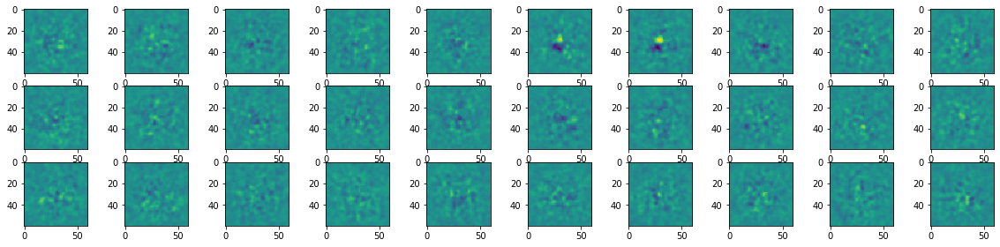

Cell  68:  R10   LLs = -0.01138758659362793
Cell  68:  R6   LL =-0.01139 ->-0.00266


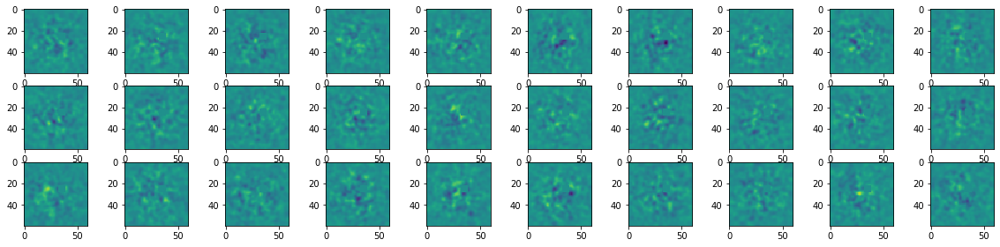

Cell  69:  R10   LLs = 0.004908144474029541
Cell  69:  R5   LL = 0.00491 -> 0.00605


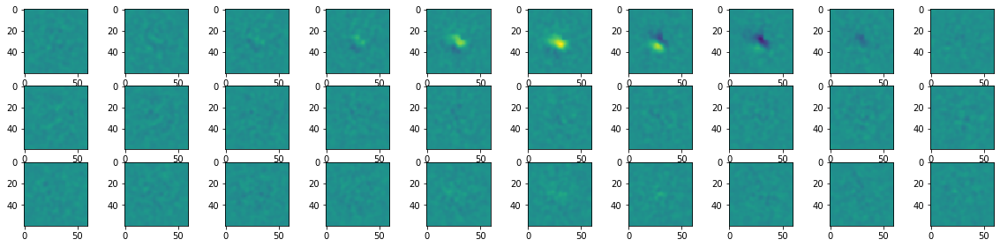

Cell  70:  R10   LLs = -0.004334449768066406
Cell  70:  R6   LL =-0.00433 -> 0.00203


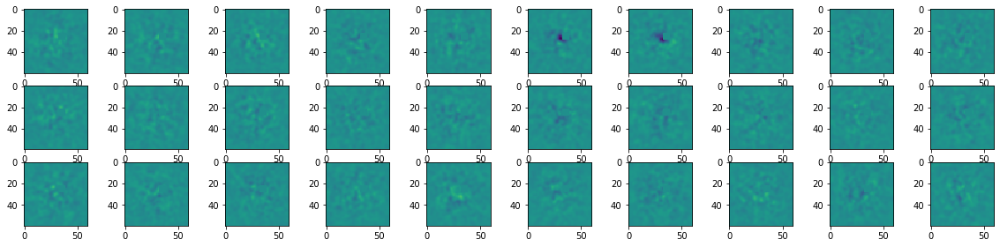

Cell  71:  R10   LLs = -0.0018308162689208984
Cell  71:  R6   LL =-0.00183 -> 0.00132


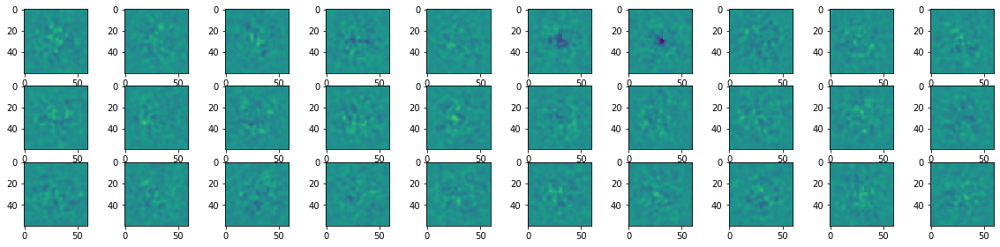

Cell  72:  R10   LLs = -0.0072743892669677734
Cell  72:  R6   LL =-0.00727 -> 0.00103


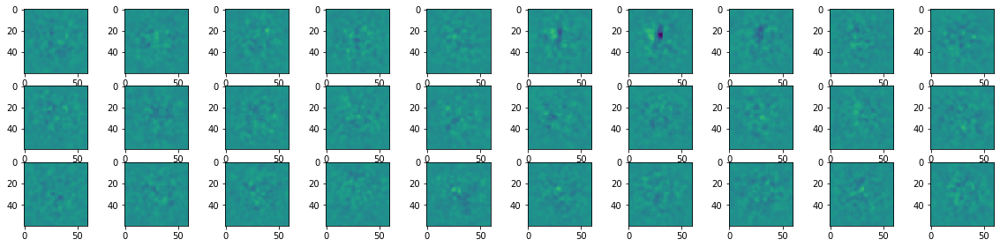

Cell  73:  R10   LLs = -0.013129949569702148
Cell  73:  R6   LL =-0.01313 ->-0.00218


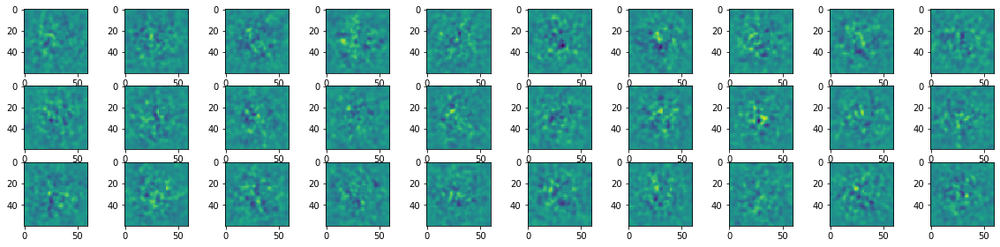

Cell  74:  R10   LLs = -0.008031129837036133
Cell  74:  R6   LL =-0.00803 ->-0.00067


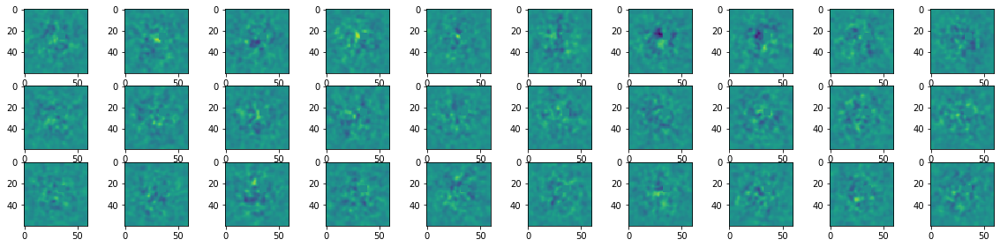

Cell  75:  R10   LLs = -0.0051729679107666016
Cell  75:  R6   LL =-0.00517 -> 0.00078


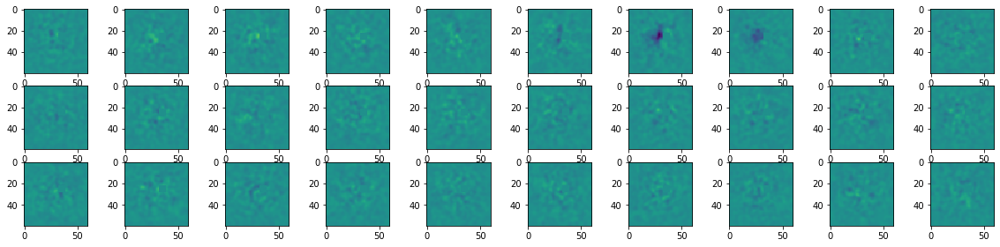

Cell  76:  R10   LLs = -0.0055092573165893555
Cell  76:  R6   LL =-0.00551 ->-0.00017


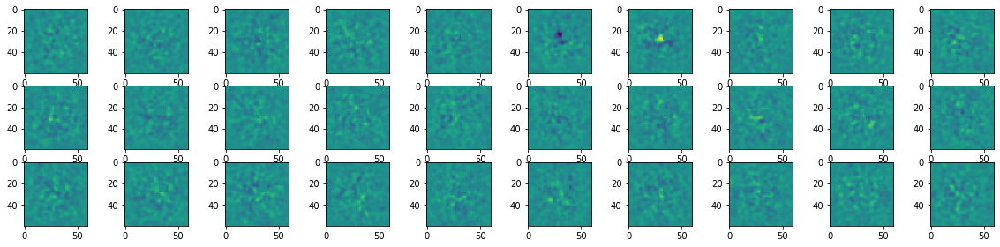

Cell  77:  R10   LLs = -0.0031851530075073242
Cell  77:  R6   LL =-0.00319 -> 0.00127


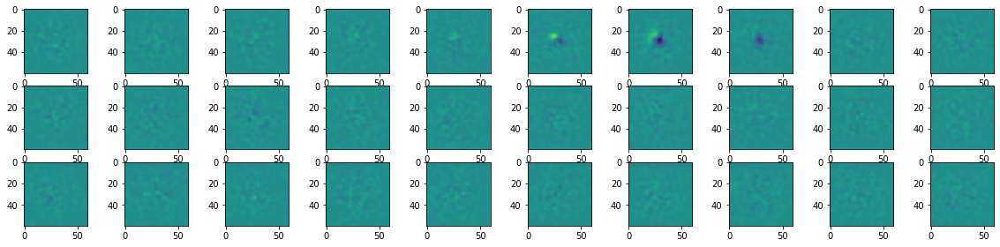

Cell  78:  R10   LLs = 0.01212620735168457
Cell  78:  R5   LL = 0.01213 -> 0.01536


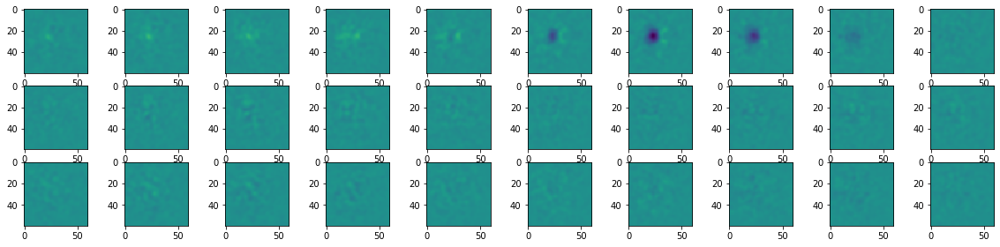

Cell  79:  R10   LLs = 0.01944756507873535
Cell  79:  R4   LL = 0.01945 -> 0.02204


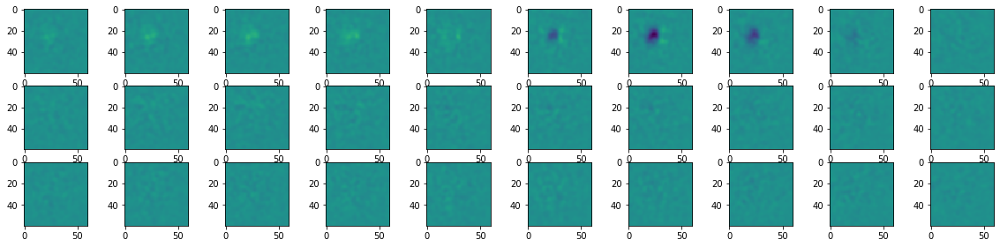

Cell  80:  R10   LLs = -0.0075893402099609375
Cell  80:  R6   LL =-0.00759 ->-0.00010


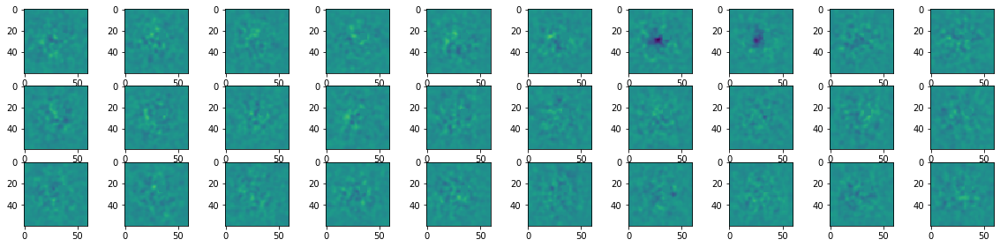

Cell  81:  R10   LLs = -0.00293576717376709
Cell  81:  R6   LL =-0.00294 -> 0.00120


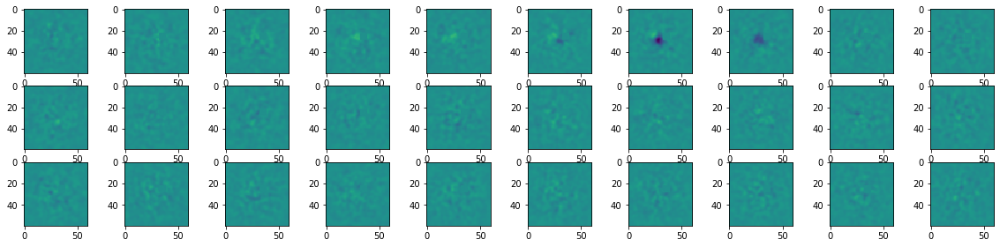

Cell  82:  R9   LLs = 0.009546279907226562
Cell  82:  R4   LL = 0.00955 -> 0.01331


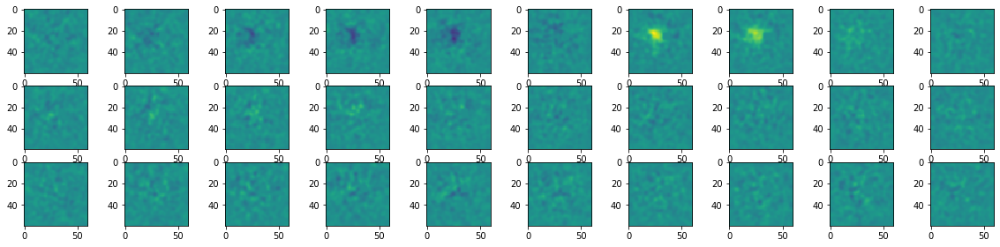

Cell  83:  R10   LLs = -0.010171890258789062
Cell  83:  R6   LL =-0.01017 ->-0.00270


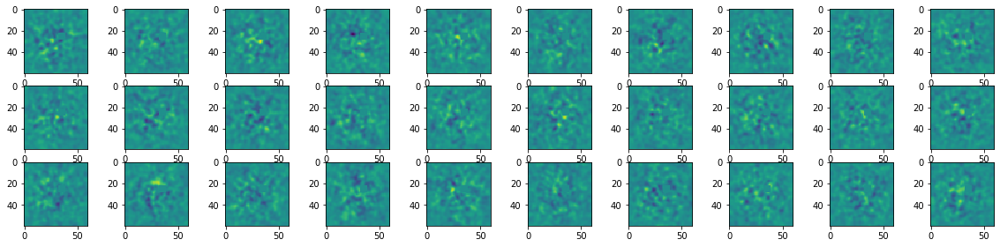

Cell  84:  R10   LLs = -0.01278066635131836
Cell  84:  R6   LL =-0.01278 ->-0.00167


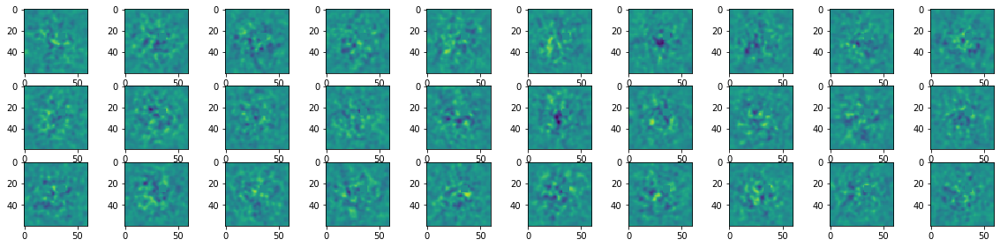

Cell  85:  R10   LLs = -0.006431102752685547
Cell  85:  R6   LL =-0.00643 -> 0.00002


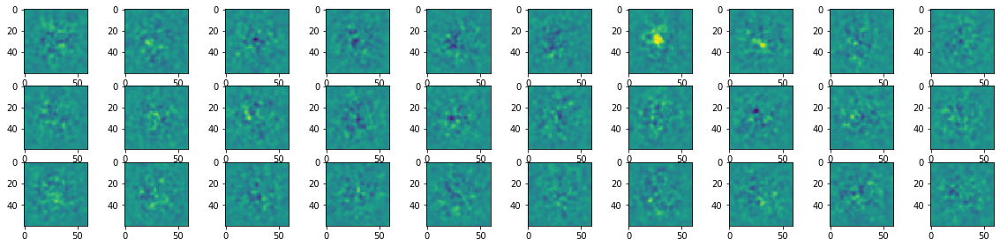

Cell  86:  R10   LLs = -0.006498575210571289
Cell  86:  R6   LL =-0.00650 ->-0.00007


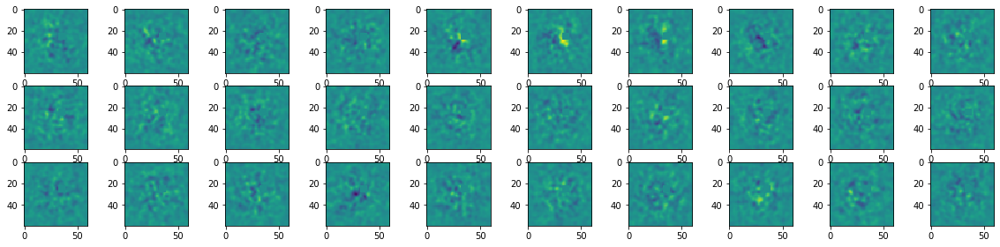

Cell  87:  R10   LLs = -0.008594036102294922
Cell  87:  R6   LL =-0.00859 ->-0.00143


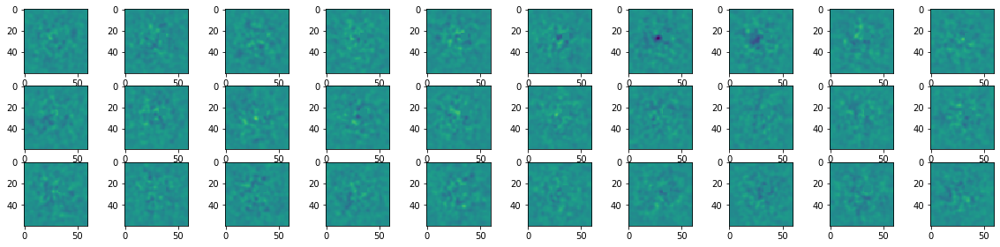

Cell  88:  R10   LLs = -0.0036122798919677734
Cell  88:  R6   LL =-0.00361 -> 0.00024


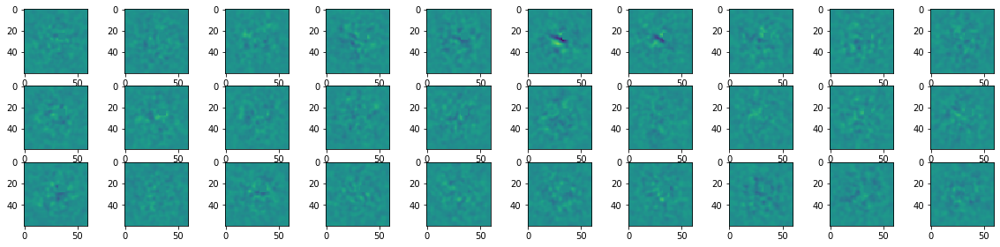

Cell  89:  R10   LLs = -0.008769512176513672
Cell  89:  R6   LL =-0.00877 ->-0.00173


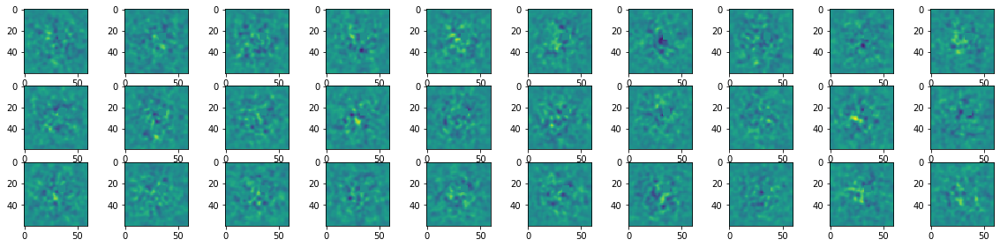

Cell  90:  R10   LLs = -0.008372306823730469
Cell  90:  R6   LL =-0.00837 ->-0.00028


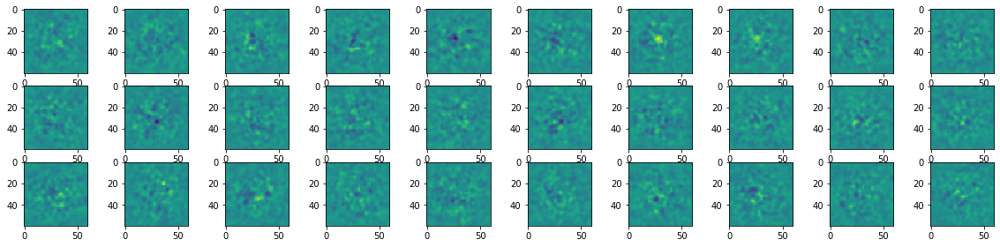

Cell  91:  R10   LLs = -0.008512496948242188
Cell  91:  R6   LL =-0.00851 ->-0.00155


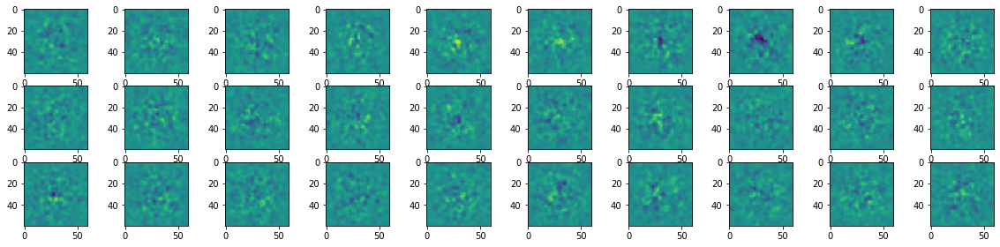

Cell  92:  R10   LLs = -0.006398677825927734
Cell  92:  R6   LL =-0.00640 ->-0.00090


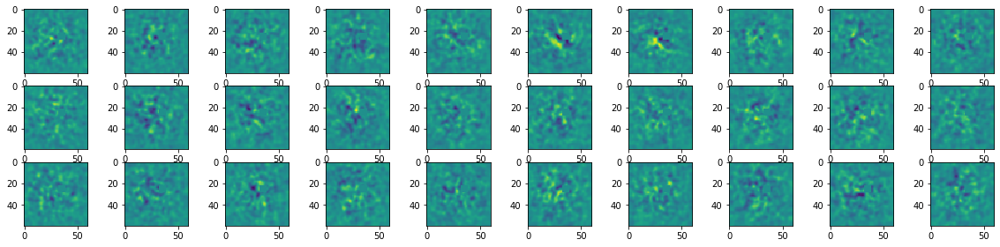

Cell  93:  R10   LLs = -0.00695347785949707
Cell  93:  R6   LL =-0.00695 ->-0.00064


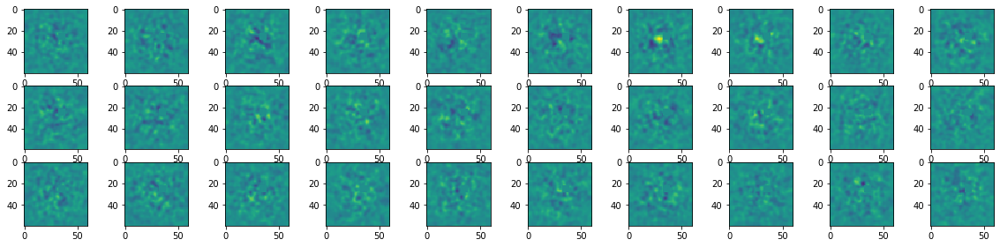

Cell  94:  R10   LLs = -0.0045223236083984375
Cell  94:  R6   LL =-0.00452 -> 0.00081


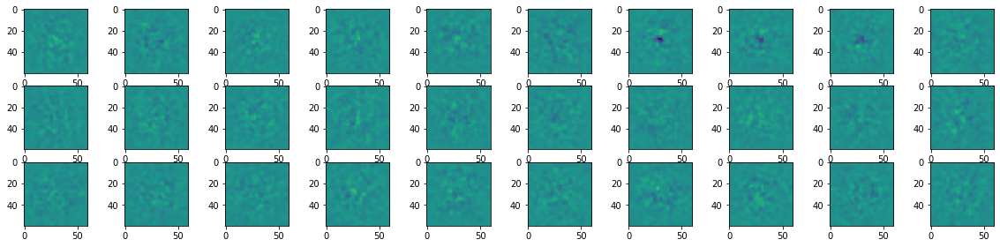

Cell  95:  R10   LLs = -0.004764080047607422
Cell  95:  R6   LL =-0.00476 -> 0.00041


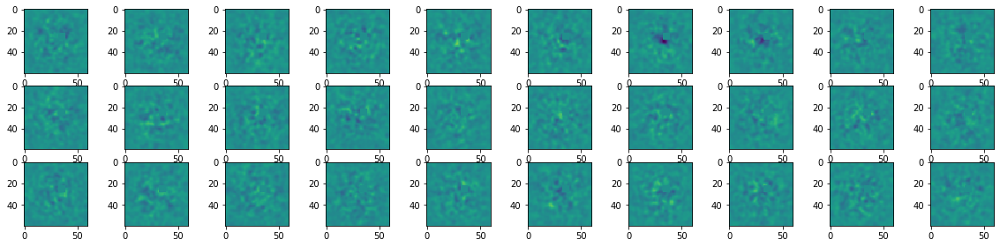

Cell  96:  R10   LLs = 0.00697934627532959
Cell  96:  R5   LL = 0.00698 -> 0.01051


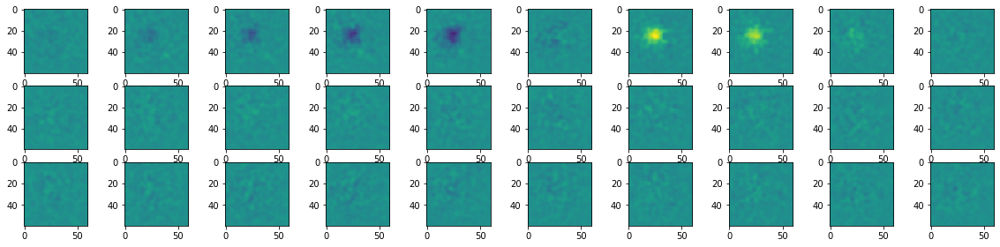

Cell  97:  R10   LLs = -0.006755828857421875
Cell  97:  R6   LL =-0.00676 ->-0.00136


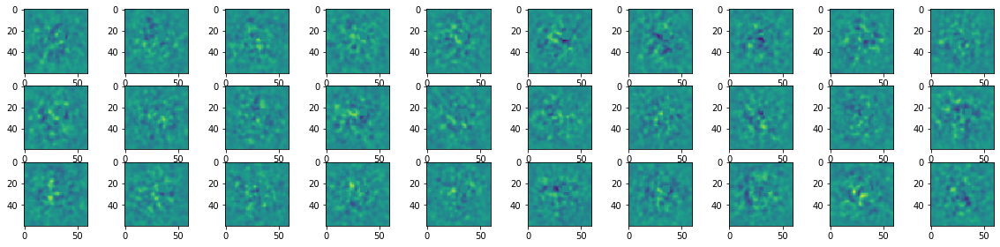

Cell  98:  R10   LLs = -0.008319616317749023
Cell  98:  R6   LL =-0.00832 ->-0.00109


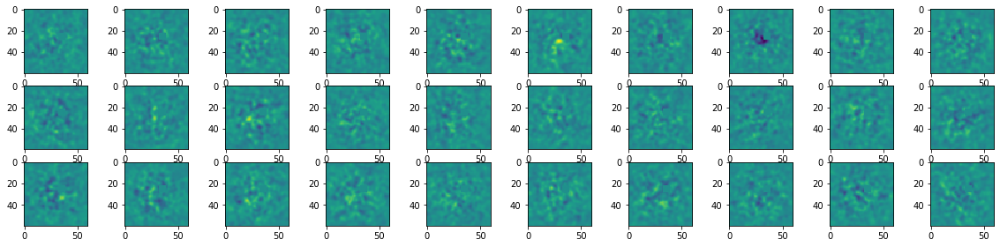

Cell  99:  R9   LLs = 0.011055469512939453
Cell  99:  R6   LL = 0.01106 -> 0.01599


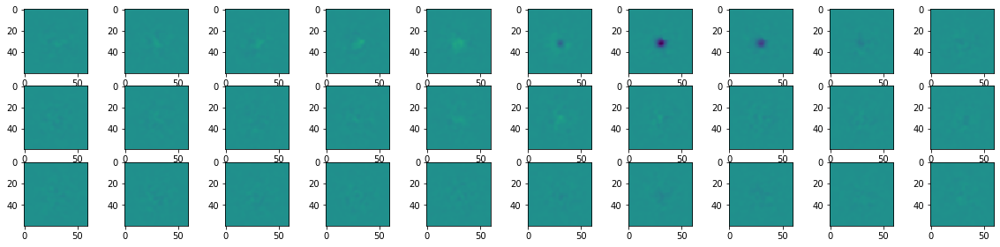

Cell 100:  R10   LLs = -0.0019266605377197266
Cell 100:  R6   LL =-0.00193 -> 0.00187


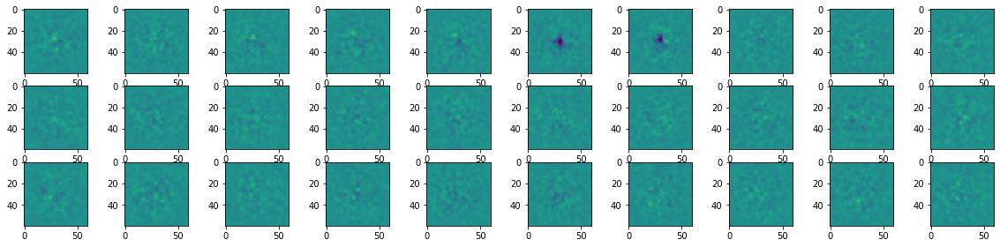

Cell 101:  R10   LLs = -0.00410151481628418
Cell 101:  R6   LL =-0.00410 -> 0.00255


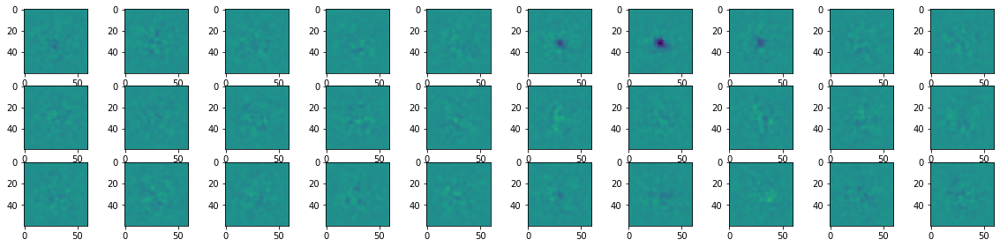

Cell 102:  R10   LLs = -0.006411314010620117
Cell 102:  R6   LL =-0.00641 ->-0.00120


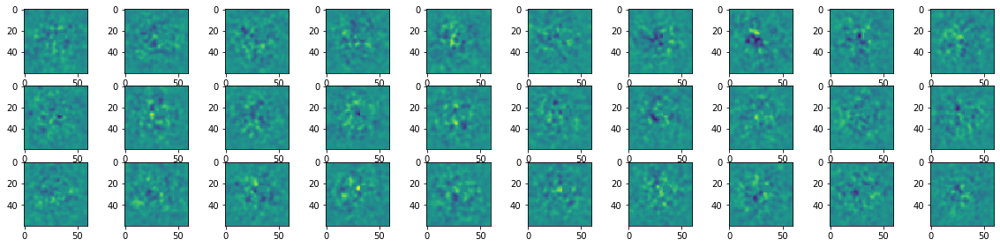

Cell 103:  R10   LLs = 0.0017116069793701172
Cell 103:  R5   LL = 0.00171 -> 0.00601


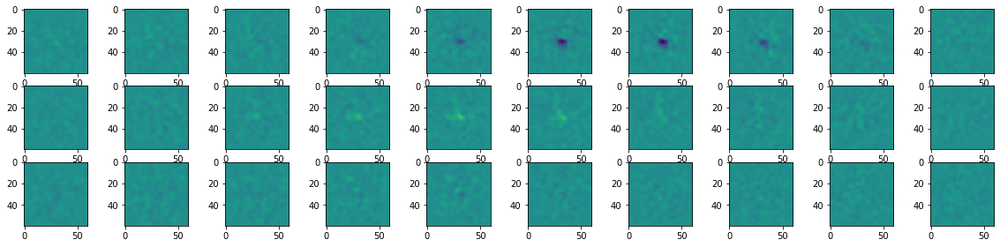

Cell 104:  R10   LLs = -0.011622905731201172
Cell 104:  R6   LL =-0.01162 ->-0.00149


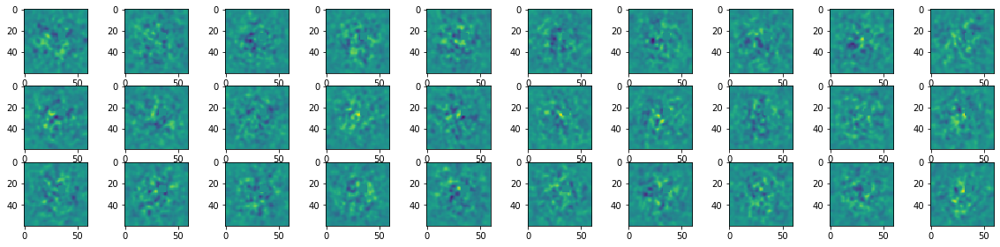

Cell 105:  R10   LLs = -0.013282060623168945
Cell 105:  R6   LL =-0.01328 ->-0.00265


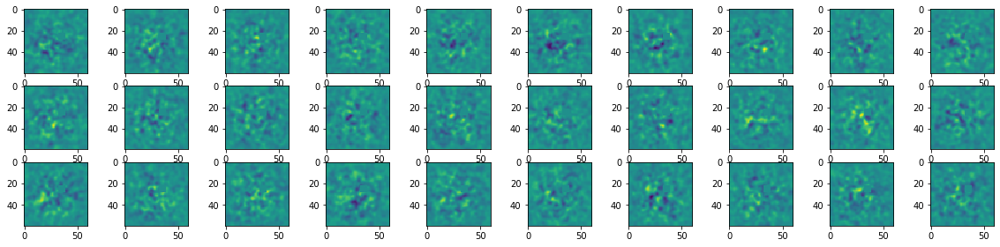

Cell 106:  R10   LLs = -0.01605391502380371
Cell 106:  R6   LL =-0.01605 ->-0.00281


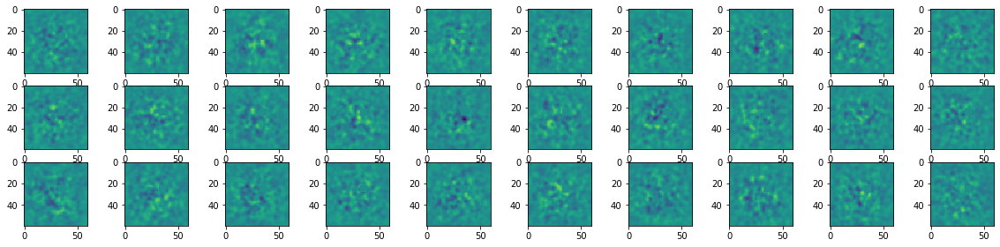

Cell 107:  R10   LLs = -0.011549234390258789
Cell 107:  R6   LL =-0.01155 ->-0.00220


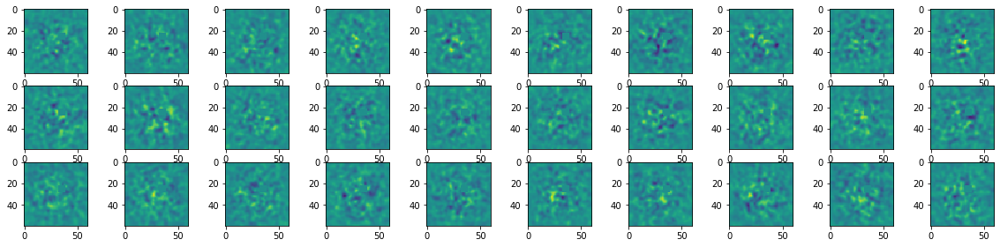

Cell 108:  R10   LLs = -0.012513399124145508
Cell 108:  R6   LL =-0.01251 ->-0.00189


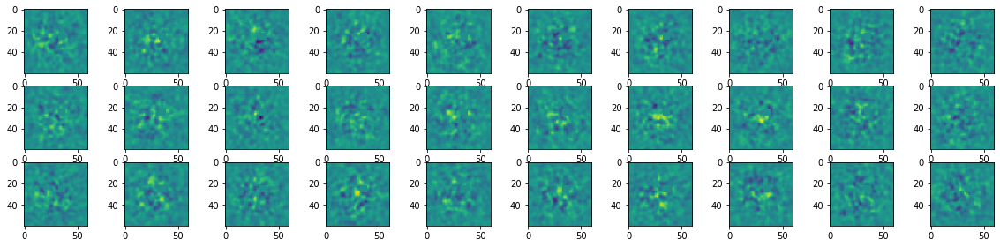

Cell 109:  R10   LLs = -0.006687641143798828
Cell 109:  R6   LL =-0.00669 ->-0.00131


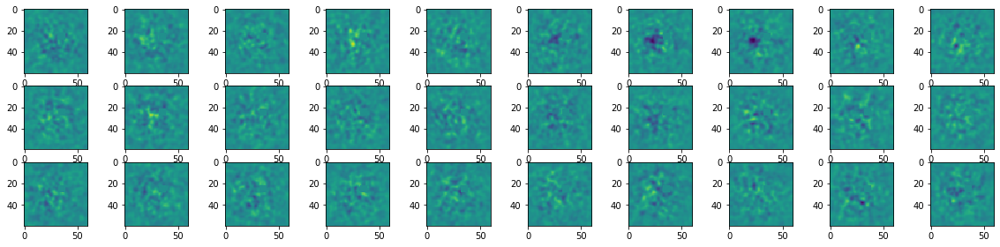

Cell 110:  R10   LLs = -0.009490728378295898
Cell 110:  R6   LL =-0.00949 ->-0.00164


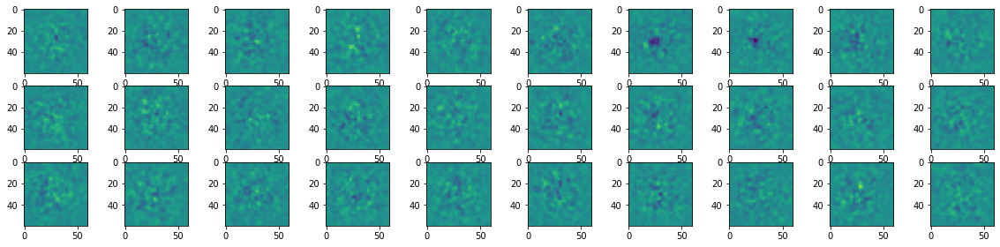

Cell 111:  R10   LLs = -0.00469660758972168
Cell 111:  R6   LL =-0.00470 ->-0.00004


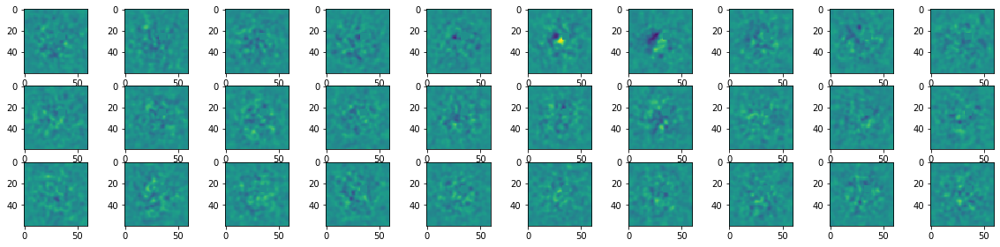

Cell 112:  R10   LLs = -0.008701086044311523
Cell 112:  R6   LL =-0.00870 ->-0.00117


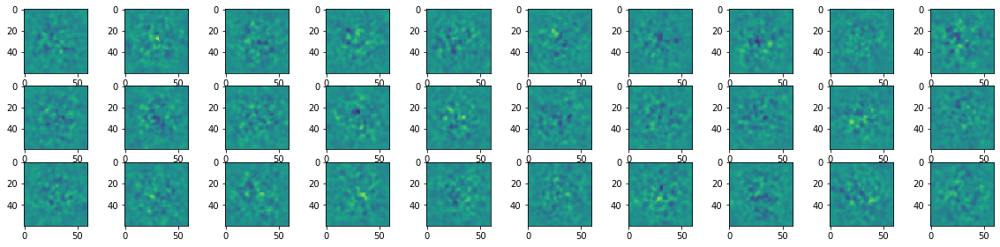

Cell 113:  R10   LLs = -0.005073428153991699
Cell 113:  R6   LL =-0.00507 ->-0.00009


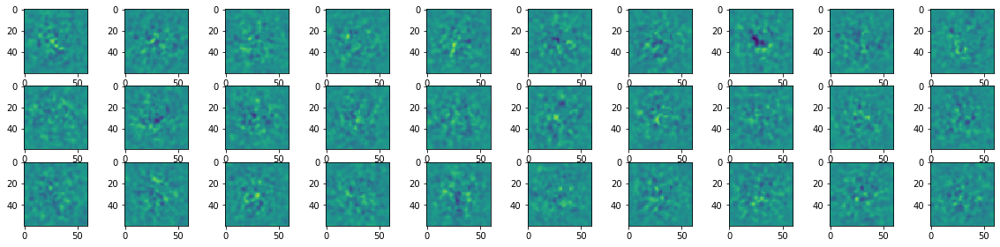

Cell 114:  R10   LLs = -0.009325265884399414
Cell 114:  R6   LL =-0.00933 ->-0.00197


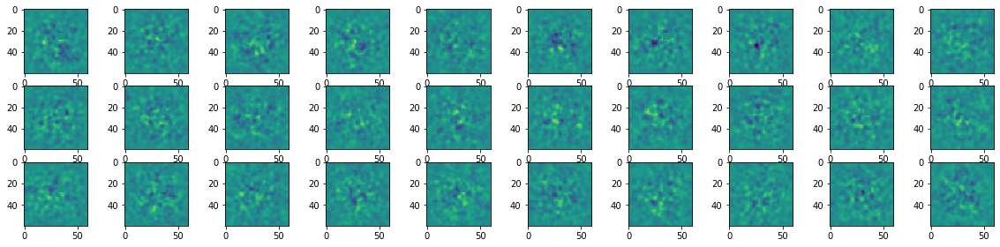

Cell 115:  R10   LLs = -0.0064013004302978516
Cell 115:  R6   LL =-0.00640 ->-0.00135


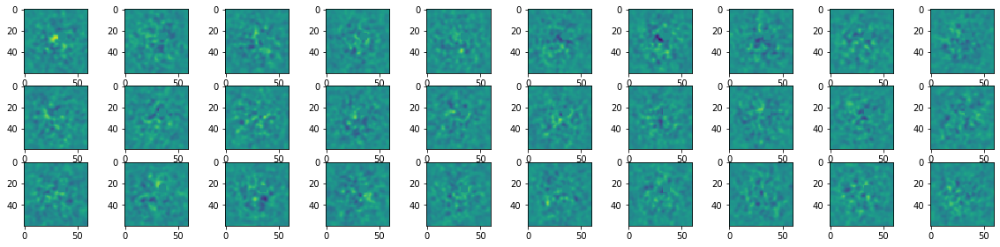

Cell 116:  R10   LLs = -0.004300355911254883
Cell 116:  R6   LL =-0.00430 ->-0.00054


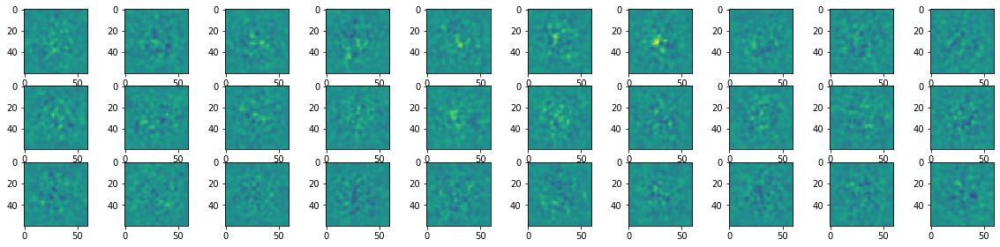

Cell 117:  R10   LLs = -0.011824846267700195
Cell 117:  R6   LL =-0.01182 ->-0.00170


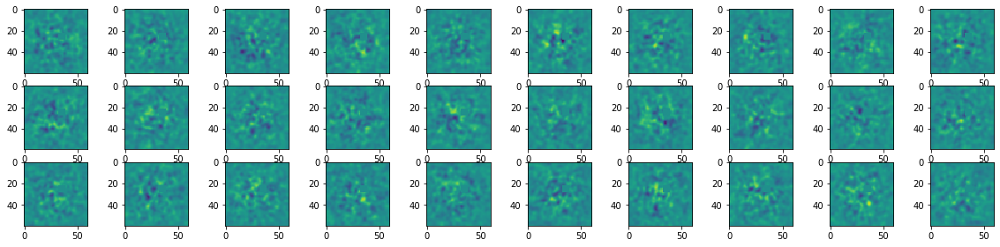

Cell 118:  R10   LLs = -0.005318641662597656
Cell 118:  R6   LL =-0.00532 -> 0.00035


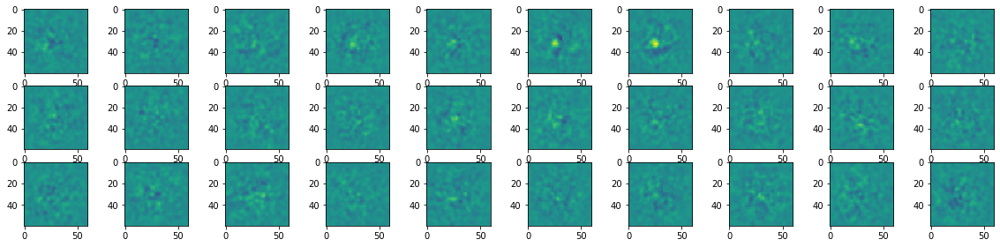

Cell 119:  R10   LLs = -0.006910562515258789
Cell 119:  R6   LL =-0.00691 ->-0.00053


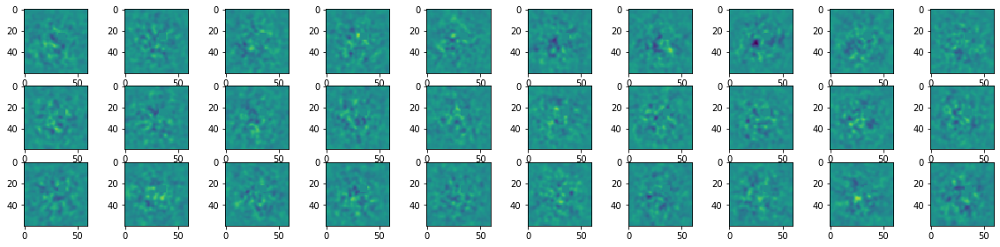

Cell 120:  R10   LLs = -0.0075702667236328125
Cell 120:  R6   LL =-0.00757 ->-0.00047


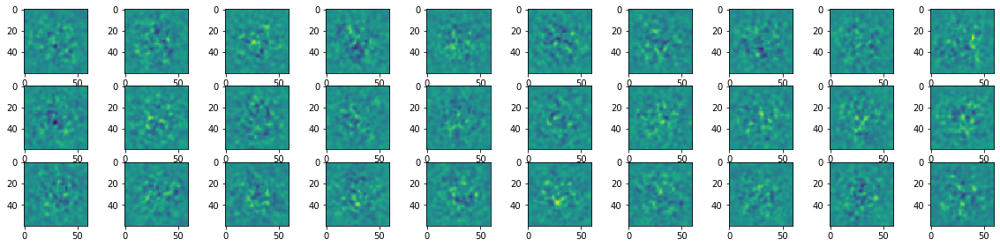

Cell 121:  R10   LLs = -0.00550532341003418
Cell 121:  R6   LL =-0.00551 ->-0.00034


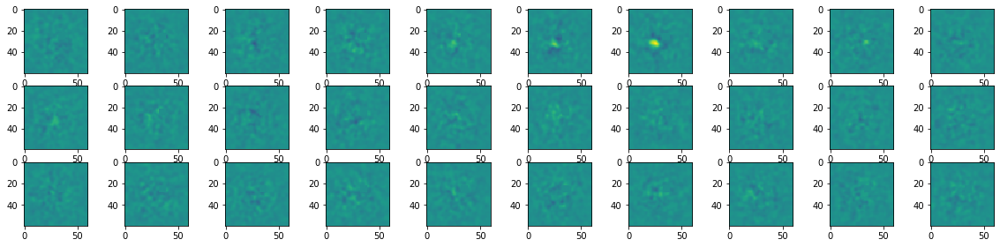

Cell 122:  R10   LLs = -0.0078125
Cell 122:  R6   LL =-0.00781 ->-0.00132


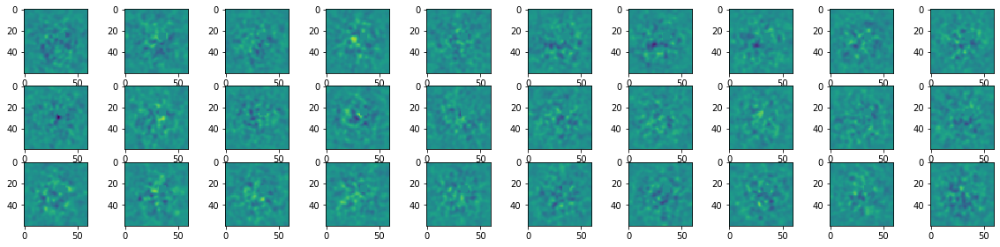

Cell 123:  R10   LLs = -0.012007951736450195
Cell 123:  R6   LL =-0.01201 ->-0.00162


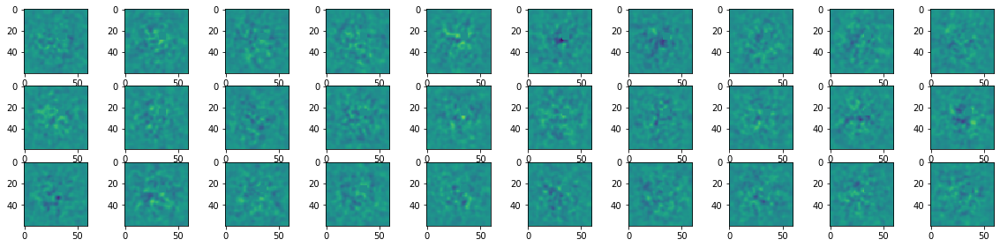

Cell 124:  R10   LLs = -0.007670879364013672
Cell 124:  R6   LL =-0.00767 ->-0.00045


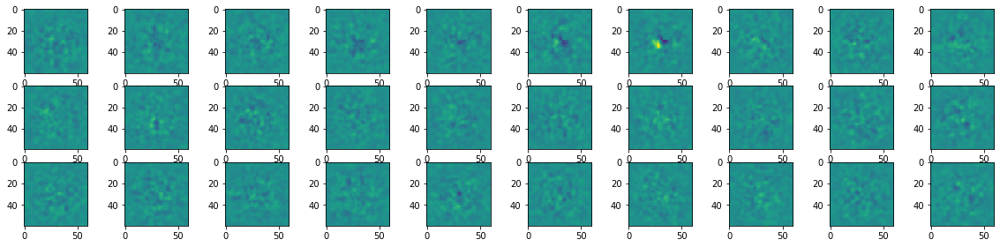

Cell 125:  R10   LLs = -0.0049027204513549805
Cell 125:  R6   LL =-0.00490 -> 0.00031


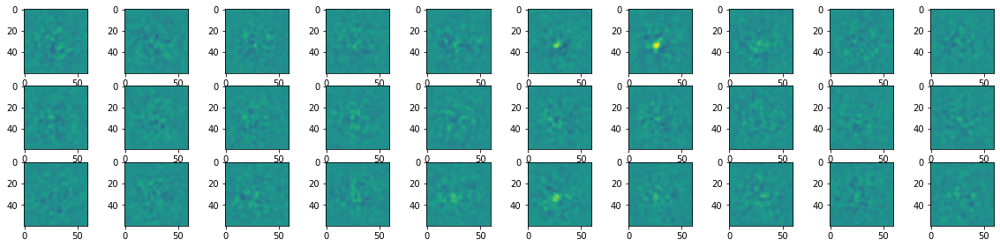

In [23]:
XTreg = 20 # [20]
L1reg = 1 # [0.5]
GLreg = 4.0 # [4.0]

glm_layer = Tlayer.layer_dict( 
    input_dims=[3,NXglm,NXglm,1], num_filters=1, bias=False, num_lags=num_lags,
    NLtype='lin', initialize_center = True)
glm_layer['reg_vals'] = {'d2xt': XTreg, 'l1': L1reg, 'glocalx': GLreg,'edge_t':100} 

stim_net =  FFnetwork.ffnet_dict( xstim_n = 'stim', layer_list = [glm_layer] )

drift_pars1 = NDNLayer.layer_dict( 
    input_dims=[1,1,1,NA], num_filters=1, bias=False, norm_type=0, NLtype='lin')
drift_pars1['reg_vals'] = {'d2t': Dreg, 'bcs':{'d2t':0} } 

# for stand-alone drift model
drift_pars1N = deepcopy(drift_pars1)
drift_pars1N['NLtype'] = 'softplus'

drift_net =  FFnetwork.ffnet_dict( xstim_n = 'Xdrift', layer_list = [drift_pars1] )

comb_layer = NDNLayer.layer_dict(
    num_filters = 1, NLtype='softplus', bias=False)
comb_layer['weights_initializer'] = 'ones'

net_comb = FFnetwork.ffnet_dict( 
    xstim_n = None, ffnet_n=[0,1],
    layer_list = [comb_layer], ffnet_type='add')

#stim_net['layer_list'][0]['reg_vals']['d2xt'] = 10
net_comb['layer_list'][0]['bias'] = True

glms = [None]*NCv
driftmods = [None]*NCv

XTopt = np.zeros(NCv) 
GLopt = np.zeros(NCv) 
LLsNULL = np.zeros(NCv)
LLsR = np.zeros([NCv,4])+1000

rvals = [0.01, 0.1, 1, 10, 30, 100, 300, 500, 1000, 3000, 10000]
rvalsG = [1, 3, 10, 30, 100, 300, 1000] # glocal

data.assemble_stimulus(top_corner=UTloc, fixdot=0, L=NXglm, time_embed=0, num_lags=num_lags)

for cc in range(NCv):
    data.cells_out = [valUT[cc]]

    drift_iter = NDN.NDN( 
        layer_list = [drift_pars1N], loss_type='poisson')
    drift_iter.block_sample=True
    drift_iter.networks[0].xstim_n = 'Xdrift'
    drift_iter.fit( data, force_dict_training=True, train_inds=None, **lbfgs_pars, verbose=0, version=1)
    LLsNULL[cc] = drift_iter.eval_models(data[data.val_blks], null_adjusted=False)[0]
    driftmods[cc] = deepcopy(drift_iter)

    LLs = np.zeros(len(rvals))+LLsR[cc,0]
    LLs = np.zeros(len(rvals))+LLsNULL[cc]
    for rr in range(len(rvals)):
        #glm_layer['reg_vals']['d2xt'] = rvals[rr]
        #stim_net =  FFnetwork.ffnet_dict( xstim_n = 'stim', layer_list = [glm_layer] )

        stim_net['layer_list'][0]['reg_vals']['d2xt'] = rvals[rr]
        glm_iter = NDN.NDN(  
            ffnet_list = [stim_net, drift_net, net_comb], loss_type='poisson')
        glm_iter.block_sample = True
        glm_iter.networks[1].layers[0].weight.data[:,0] = deepcopy(
            driftmods[cc].networks[0].layers[0].weight.data[:,0])
        glm_iter.networks[2].layers[0].set_parameters(val=False,name='weight')
        glm_iter.networks[1].layers[0].set_parameters(val=False)

        glm_iter.fit( data, force_dict_training=True, **lbfgs_pars, seed=5, version=9, verbose=0)
        LLi = glm_iter.eval_models(data[data.val_blks], null_adjusted=False)[0]
        if (rr == 0) or (LLi < np.min(LLs)):
            best_model = deepcopy(glm_iter)
        LLs[rr] = LLi

    bm = np.argmin(LLs)

    LLsR[cc,0] = LLs[bm]
    XTopt[cc] = rvals[bm]
    print( "Cell %3d:  R%d   LLs ="%(cc, bm), LLsNULL[cc]-LLsR[cc,0] )
    bm = np.argmin(LLs)
    XTopt[cc] = rvals[bm]
    glms[cc] = deepcopy(best_model)

    LLs = np.zeros(len(rvalsG))+LLsR[cc,0]
    for rr in range(len(rvalsG)):
        glm_iter = deepcopy(best_model)
        glm_iter.networks[0].layers[0].reg.vals['glocalx'] = rvals[rr]
        glm_iter.fit( data, force_dict_training=True, **lbfgs_pars, seed=5, version=9, verbose=0)
        LLi = glm_iter.eval_models(data[data.val_blks], null_adjusted=False)[0]
        if (rr == 0) or (LLi < np.min(LLs)):
            best_model = deepcopy(glm_iter)
        LLs[rr] = LLi

    bm = np.argmin(LLs)
    LLsR[cc,1] = LLs[bm]
    GLopt[cc] = rvals[bm]
    glms[cc] = deepcopy(best_model)
    print( "Cell %3d:  R%d   LL =%8.5f ->%8.5f"%(cc, bm, LLsNULL[cc]-LLsR[cc,0], LLsNULL[cc]-LLsR[cc,1]) )
    w = best_model.get_weights()

    w = best_model.get_weights()
    utils.subplot_setup(1,num_lags, row_height=4)
    for ll in range(num_lags):
        plt.subplot(3,num_lags,ll+1)
        utils.imagesc(w[0,:,:,ll,0], aspect=1, max=np.max(np.abs(w)))
        plt.subplot(3,num_lags,ll+1+num_lags)
        utils.imagesc(w[1,:,:,ll,0], aspect=1, max=np.max(np.abs(w)))
        plt.subplot(3,num_lags,ll+1+num_lags*2)
        utils.imagesc(w[2,:,:,ll,0], aspect=1, max=np.max(np.abs(w)))
    plt.show()

In [24]:
# Assemble population drift terms
w0 = driftmods[0].get_weights()
NA = w0.shape[0]
drift_terms = np.zeros([NA, NCv])
for cc in range(NCv):
    drift_terms[:, cc] = deepcopy(driftmods[cc].get_weights())[:,0]

# Assemble drift population model
drift_pars_pop = NDNLayer.layer_dict( 
    input_dims=[1,1,1,NA], num_filters=NCv, bias=False, norm_type=0, NLtype='softplus')
drift_pars_pop['reg_vals'] = {'d2t': Dreg, 'bcs':{'d2t':0} } 
drift_pop = NDN.NDN( layer_list=[drift_pars_pop], loss_type='poisson')
drift_pop.block_sample=True
drift_pop.networks[0].xstim_n = 'Xdrift'
drift_pop.networks[0].layers[0].weight.data = torch.tensor(drift_terms, dtype=torch.float32)
data.set_cells(valUT)
LLsCHECK = drift_pop.eval_models(data[data.val_blks], null_adjusted=False) 
print(np.mean(LLsNULL), np.mean(LLsCHECK))

Output set to 126 cells
2.625989323097562 2.6259892


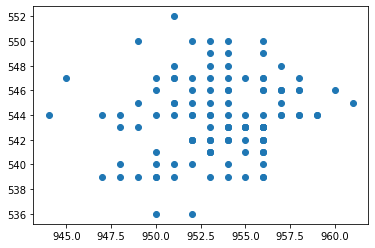

In [25]:
# Get array centers
RFcenters = np.zeros([NCv,2], dtype=np.int64) - 1
for cc in range(NCv):
    k = glms[cc].get_weights()
    pfilt = np.sum(np.std(k, axis=3),axis=0).squeeze() # for colorRFs
#    pfilt = np.std(k, axis=2).squeeze() # for Lum RFs
    x,y = utils.max_multiD( pfilt )
    RFcenters[cc, :] = [x,y]   

RFcenters[:,0] = RFcenters[:,0] + UTloc[0]
RFcenters[:,1] = RFcenters[:,1] + UTloc[1]
plt.plot(RFcenters[:, 0], RFcenters[:, 1],'o')
plt.show()

In [26]:
# Generate full GLM model like full drift model
glm_layer = Tlayer.layer_dict( 
    input_dims=[3,NXglm,NXglm,1], num_filters=NCv, bias=False, num_lags=num_lags,
    NLtype='lin', initialize_center = True)
glm_layer['reg_vals'] = {'d2xt': XTreg, 'l1': L1reg, 'glocalx': GLreg,'edge_t':100} 

stim_net =  FFnetwork.ffnet_dict( xstim_n='stim', layer_list=[glm_layer] )

drift_pars = NDNLayer.layer_dict( 
    input_dims=[1,1,1,NA], num_filters=NCv, bias=False, norm_type=0, NLtype='lin')
drift_pars['reg_vals'] = {'d2t': Dreg, 'bcs':{'d2t':0} } 

drift_net =  FFnetwork.ffnet_dict( xstim_n = 'Xdrift', layer_list=[drift_pars] )

comb_layer = ChannelLayer.layer_dict( num_filters=NCv, NLtype='softplus', bias=True )
comb_layer['weights_initializer'] = 'ones'

net_comb = FFnetwork.ffnet_dict( 
    xstim_n = None, ffnet_n=[0,1],
    layer_list = [comb_layer], ffnet_type='add')

glm_all = NDN.NDN(  
            ffnet_list = [stim_net, drift_net, net_comb], loss_type='poisson')

for cc in range(NCv):
    glm_all.networks[0].layers[0].weight.data[:, cc] = deepcopy(glms[cc].networks[0].layers[0].weight.data[:,0])
    glm_all.networks[1].layers[0].weight.data[:, cc] = deepcopy(glms[cc].networks[1].layers[0].weight.data[:,0])
    glm_all.networks[-1].layers[0].bias.data[cc] = deepcopy(glms[cc].networks[-1].layers[0].bias.data)

data.set_cells(valUT)
LLsCHECK = glm_all.eval_models(data[data.val_blks], null_adjusted=False) 
print(np.mean(LLsNULL-LLsR[:,1]), np.mean(LLsNULL-LLsCHECK))

Output set to 126 cells
0.0016073201383863176 0.0016073243958609445


In [27]:
LLsGLM = LLsNULL-LLsR[:,1]
sio.savemat(datadir2+PROOT+'_UT_GLM_info.mat', {
    'LLsNULL':LLsNULL[:,None], 'LLsGLM':LLsGLM[:, None], 'drift_terms': drift_terms, 'Dreg': Dreg,
    'RFcenters': RFcenters, 'top_corner': UTloc, 'valUT':valUT, 'NX': UNX})
sio.savemat(datadir2+PROOT+'_UT_stimpos.mat', {
    'LLsNULL':LLsNULL[:,None], 'LLsGLM':LLsGLM[:, None], 'drift_terms': drift_terms, 'Dreg': Dreg,
    'RFcenters': RFcenters, 'top_corner': UTloc, 'valUT':valUT, 'NX': UNX, 'source':'glms'})
drift_pop.save_model(filename=moddir+'UT_drift_pop.pkl')
glm_all.save_model(filename=moddir+'UT_GLM_ET_pop.pkl')

for cc in range(NCv):
    glms[cc].save_model(
        filename=moddir+'UTglm' + utils.filename_num2str(cc, num_digits=3) + '_iter0.pkl')

  Saving model at /Data/FelixData/Conway/proc/J220711/models/UT_drift_pop.pkl
  Saving model at /Data/FelixData/Conway/proc/J220711/models/UT_GLM_ET_pop.pkl
  Saving model at /Data/FelixData/Conway/proc/J220711/models/UTglm000_iter0.pkl
  Saving model at /Data/FelixData/Conway/proc/J220711/models/UTglm001_iter0.pkl
  Saving model at /Data/FelixData/Conway/proc/J220711/models/UTglm002_iter0.pkl
  Saving model at /Data/FelixData/Conway/proc/J220711/models/UTglm003_iter0.pkl
  Saving model at /Data/FelixData/Conway/proc/J220711/models/UTglm004_iter0.pkl
  Saving model at /Data/FelixData/Conway/proc/J220711/models/UTglm005_iter0.pkl
  Saving model at /Data/FelixData/Conway/proc/J220711/models/UTglm006_iter0.pkl
  Saving model at /Data/FelixData/Conway/proc/J220711/models/UTglm007_iter0.pkl
  Saving model at /Data/FelixData/Conway/proc/J220711/models/UTglm008_iter0.pkl
  Saving model at /Data/FelixData/Conway/proc/J220711/models/UTglm009_iter0.pkl
  Saving model at /Data/FelixData/Conway/pr

  Saving model at /Data/FelixData/Conway/proc/J220711/models/UTglm105_iter0.pkl
  Saving model at /Data/FelixData/Conway/proc/J220711/models/UTglm106_iter0.pkl
  Saving model at /Data/FelixData/Conway/proc/J220711/models/UTglm107_iter0.pkl
  Saving model at /Data/FelixData/Conway/proc/J220711/models/UTglm108_iter0.pkl
  Saving model at /Data/FelixData/Conway/proc/J220711/models/UTglm109_iter0.pkl
  Saving model at /Data/FelixData/Conway/proc/J220711/models/UTglm110_iter0.pkl
  Saving model at /Data/FelixData/Conway/proc/J220711/models/UTglm111_iter0.pkl
  Saving model at /Data/FelixData/Conway/proc/J220711/models/UTglm112_iter0.pkl
  Saving model at /Data/FelixData/Conway/proc/J220711/models/UTglm113_iter0.pkl
  Saving model at /Data/FelixData/Conway/proc/J220711/models/UTglm114_iter0.pkl
  Saving model at /Data/FelixData/Conway/proc/J220711/models/UTglm115_iter0.pkl
  Saving model at /Data/FelixData/Conway/proc/J220711/models/UTglm116_iter0.pkl
  Saving model at /Data/FelixData/Conway

In [28]:
glm_ks = np.zeros([NCv, 3, NXglm, NXglm, num_lags]) 
for cc in range(NCv):
    glm_ks[cc,:,:,:,:] = glms[cc].get_weights().squeeze()
glm_ks.shape

(126, 3, 60, 60, 10)

In [29]:
sio.savemat(analdir+PROOT+'_UT_GLM_measures.mat', {
    'glm_ks':glm_ks, 'valUT':valUT, 'LLsGLM':LLsGLM[:, None], 'top_corner': UTloc,
    'RFcenters': RFcenters})

## Now do NForm for completion

  Writing lam stim 0: overlap 59, 36
  Writing lam stim 1: overlap 59, 24
  Writing ETstim 0: overlap 2, 26
  Writing ETstim 1: overlap 3, 34
  Adding fixation point
  Done


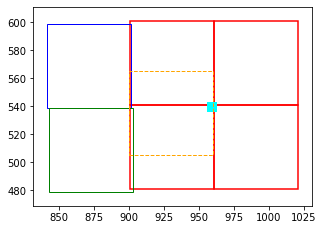

In [30]:
NFloc = np.array([900, 505], dtype=np.int64)

data.assemble_stimulus(top_corner=NFloc, fixdot=0, L=UNX, time_embed=0)
Reff = torch.mul(data.robs[:, valNF], data.dfs[:, valNF])
nspks = torch.sum(Reff, axis=0)

data.draw_stim_locations( top_corner=NFloc, L=UNX)

In [31]:
## Calculate STAS
lag = 4
stasC = ((data.stim[:-lag, ...].T @ Reff[lag:,:]).squeeze() / nspks).reshape([3, UNX,UNX,-1]).numpy()
stasC.shape

(3, 60, 60, 7)

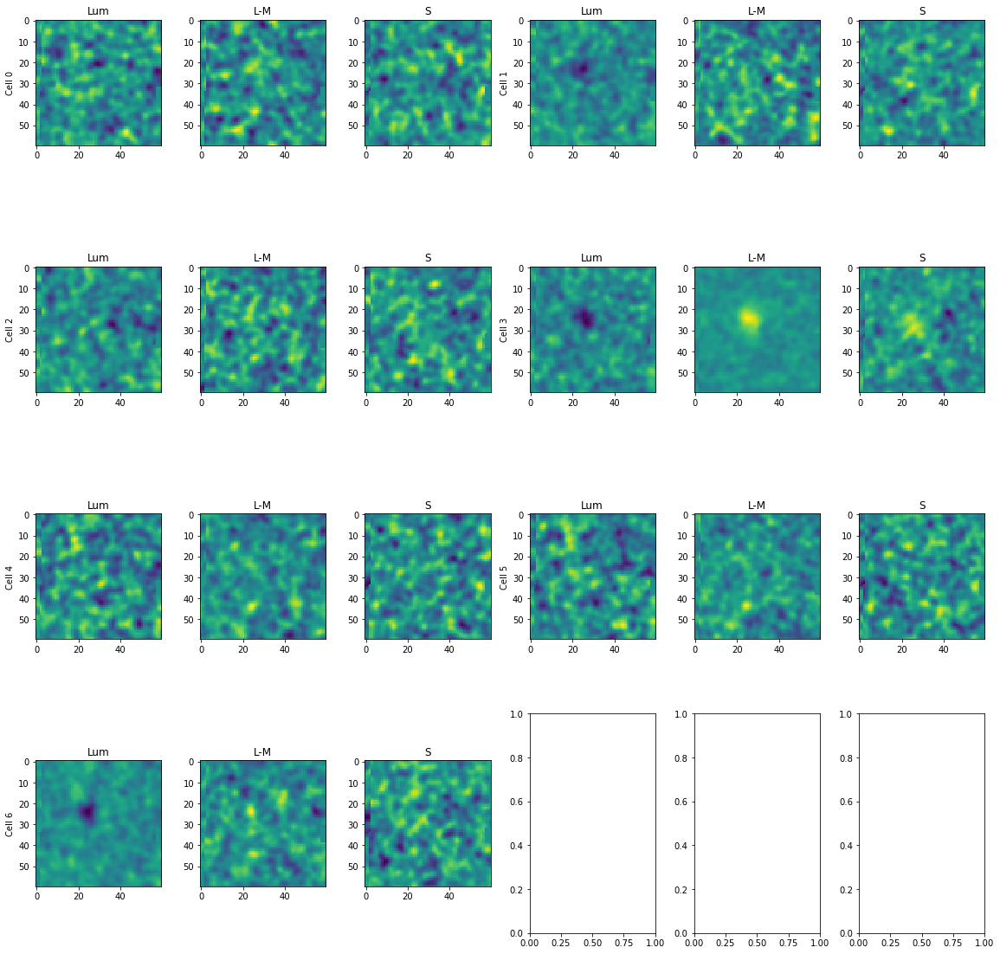

In [32]:
ctext = ['Lum', 'L-M', 'S']
Nrows=int(np.ceil(NCNF/2))
ss(Nrows, 6, rh=4)
for cc in range(NCNF):
    for clr in range(3):
        plt.subplot(Nrows, 6, 3*cc+clr+1)
        imagesc(stasC[clr, :, :, cc])
        if clr == 0:
            plt.ylabel( "Cell %d"%cc)
        plt.title(ctext[clr])

In [33]:
NCv=NCNF

NXglm = UNX
#num_lags = 10

LLs0, LLsGLM, XTopt, GLopt = np.zeros([NCv,2]), np.zeros(NCv), np.zeros(NCv), np.zeros(NCv)
glms = [None]*NCv
driftmods = [None]*NCv
Dreg = 0.1

lbfgs_pars = utils.create_optimizer_params(
    optimizer_type='lbfgs',
    tolerance_change=1e-10,
    tolerance_grad=1e-10,
    batch_size=16000,
    max_epochs=3,
    max_iter = 200)
#lbfgs_pars['num_workers'] = 0

  Writing lam stim 0: overlap 59, 36
  Writing lam stim 1: overlap 59, 24
  Writing ETstim 0: overlap 2, 26
  Writing ETstim 1: overlap 3, 34
  Adding fixation point
  Done
Output set to 1 cells
Cell   0:  R10   LLs = -0.010965347290039062
Cell   0:  R6   LL =-0.01097 ->-0.00230


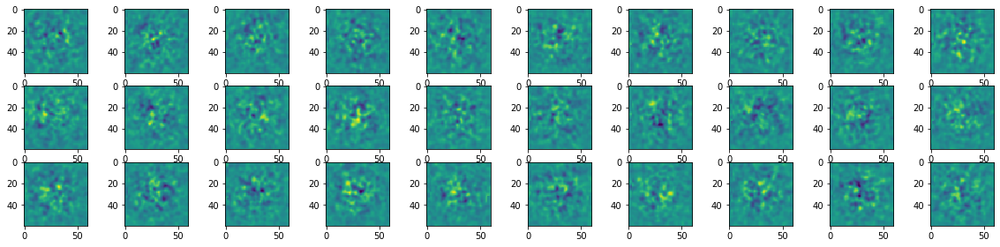

Output set to 1 cells
Cell   1:  R10   LLs = -0.009522199630737305
Cell   1:  R6   LL =-0.00952 ->-0.00030


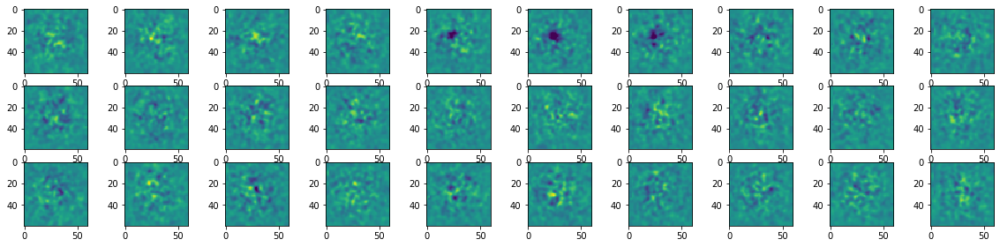

Output set to 1 cells
Cell   2:  R10   LLs = -0.008521080017089844
Cell   2:  R6   LL =-0.00852 ->-0.00153


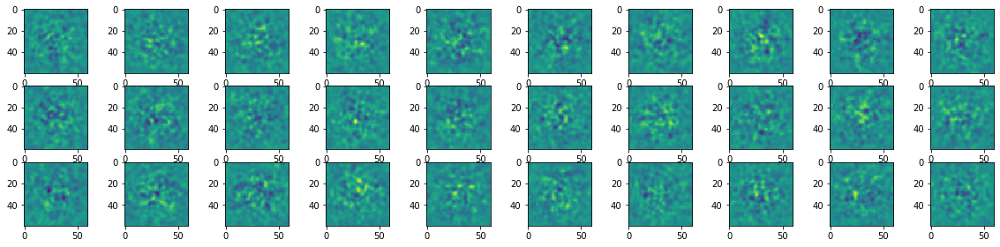

Output set to 1 cells
Cell   3:  R10   LLs = 0.050582170486450195
Cell   3:  R3   LL = 0.05058 -> 0.05092


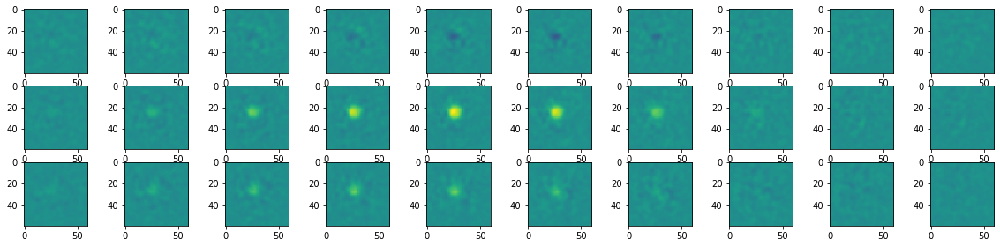

Output set to 1 cells
Cell   4:  R10   LLs = -0.009422540664672852
Cell   4:  R6   LL =-0.00942 ->-0.00156


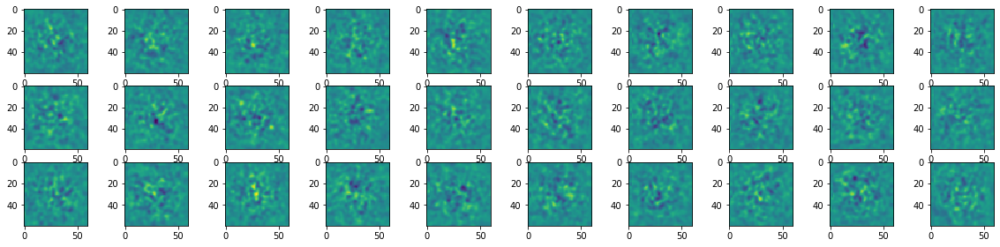

Output set to 1 cells
Cell   5:  R10   LLs = -0.008132219314575195
Cell   5:  R6   LL =-0.00813 ->-0.00077


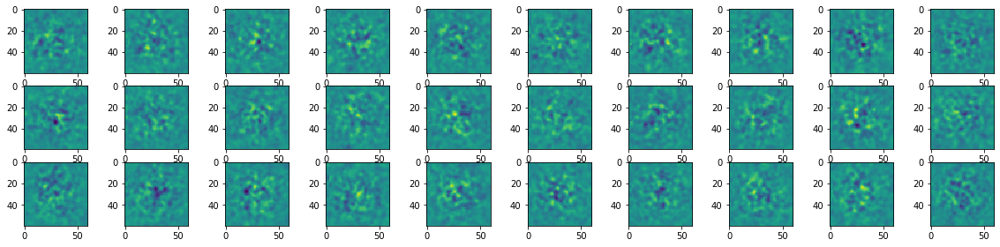

Output set to 1 cells
Cell   6:  R10   LLs = 0.0053250789642333984
Cell   6:  R4   LL = 0.00533 -> 0.00806


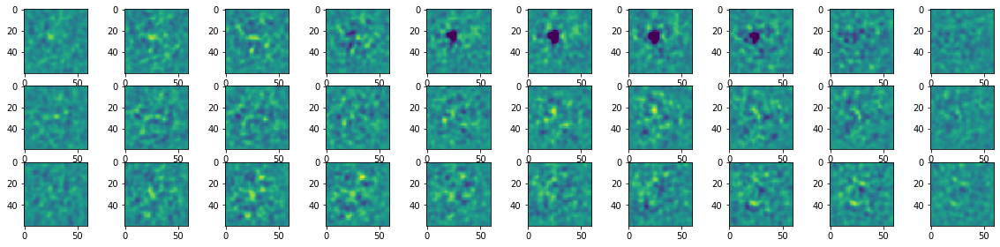

In [34]:
XTreg = 20 # [20]
L1reg = 0.1 # [0.5]
GLreg = 4.0 # [4.0]

glm_layer = Tlayer.layer_dict( 
    input_dims=[3,NXglm,NXglm,1], num_filters=1, bias=False, num_lags=num_lags,
    NLtype='lin', initialize_center = True)
glm_layer['reg_vals'] = {'d2xt': XTreg, 'l1': L1reg, 'glocalx': GLreg,'edge_t':100} 

stim_net =  FFnetwork.ffnet_dict( xstim_n = 'stim', layer_list = [glm_layer] )

drift_pars1 = NDNLayer.layer_dict( 
    input_dims=[1,1,1,NA], num_filters=1, bias=False, norm_type=0, NLtype='lin')
drift_pars1['reg_vals'] = {'d2t': Dreg, 'bcs':{'d2t':0} } 

# for stand-alone drift model
drift_pars1N = deepcopy(drift_pars1)
drift_pars1N['NLtype'] = 'softplus'

drift_net =  FFnetwork.ffnet_dict( xstim_n = 'Xdrift', layer_list = [drift_pars1] )

comb_layer = NDNLayer.layer_dict(
    num_filters = 1, NLtype='softplus', bias=False)
comb_layer['weights_initializer'] = 'ones'

net_comb = FFnetwork.ffnet_dict( 
    xstim_n = None, ffnet_n=[0,1],
    layer_list = [comb_layer], ffnet_type='add')

#stim_net['layer_list'][0]['reg_vals']['d2xt'] = 10
net_comb['layer_list'][0]['bias'] = True

glms = [None]*NCv
driftmods = [None]*NCv

XTopt = np.zeros(NCv) 
GLopt = np.zeros(NCv) 
LLsNULL = np.zeros(NCv)
LLsR = np.zeros([NCv,2])+1000

rvals = [0.01, 0.1, 1, 10, 30, 100, 300, 500, 1000, 3000, 10000]
rvalsG = [1, 3, 10, 30, 100, 300, 1000] # glocal

data.assemble_stimulus(top_corner=NFloc, fixdot=0, L=NXglm, time_embed=0, num_lags=num_lags)

for cc in range(NCv):
    data.set_cells([valNF[cc]])

    drift_iter = NDN.NDN( 
        layer_list = [drift_pars1N], loss_type='poisson')
    drift_iter.block_sample=True
    drift_iter.networks[0].xstim_n = 'Xdrift'
    drift_iter.fit( data, force_dict_training=True, train_inds=None, **lbfgs_pars, verbose=0, version=1)
    LLsNULL[cc] = drift_iter.eval_models(data[data.val_blks], null_adjusted=False)[0]
    driftmods[cc] = deepcopy(drift_iter)

    LLs = np.zeros(len(rvals))+LLsR[cc,0]
    LLs = np.zeros(len(rvals))+LLsNULL[cc]
    for rr in range(len(rvals)):
        #glm_layer['reg_vals']['d2xt'] = rvals[rr]
        #stim_net =  FFnetwork.ffnet_dict( xstim_n = 'stim', layer_list = [glm_layer] )

        stim_net['layer_list'][0]['reg_vals']['d2xt'] = rvals[rr]
        glm_iter = NDN.NDN(  
            ffnet_list = [stim_net, drift_net, net_comb], loss_type='poisson')
        glm_iter.block_sample=True        
        glm_iter.networks[1].layers[0].weight.data[:,0] = deepcopy(
            driftmods[cc].networks[0].layers[0].weight.data[:,0])
        glm_iter.networks[2].layers[0].set_parameters(val=False,name='weight')
        glm_iter.networks[1].layers[0].set_parameters(val=False)

        glm_iter.fit( data, force_dict_training=True, **lbfgs_pars, seed=5, version=9, verbose=0)
        LLi = glm_iter.eval_models(data[data.val_blks], null_adjusted=False)[0]
        if (rr == 0) or (LLi < np.min(LLs)):
            best_model = deepcopy(glm_iter)
        LLs[rr] = LLi

    bm = np.argmin(LLs)

    LLsR[cc,0] = LLs[bm]
    XTopt[cc] = rvals[bm]
    print( "Cell %3d:  R%d   LLs ="%(cc, bm), LLsNULL[cc]-LLsR[cc,0] )
    bm = np.argmin(LLs)
    XTopt[cc] = rvals[bm]
    glms[cc] = deepcopy(best_model)

    LLs = np.zeros(len(rvalsG))+LLsR[cc,0]
    for rr in range(len(rvalsG)):
        glm_iter = deepcopy(best_model)
        glm_iter.networks[0].layers[0].reg.vals['glocalx'] = rvals[rr]
        glm_iter.fit( data, force_dict_training=True, **lbfgs_pars, seed=5, verbose=0)
        LLi = glm_iter.eval_models(data[data.val_blks], null_adjusted=False)[0]
        if (rr == 0) or (LLi < np.min(LLs)):
            best_model = deepcopy(glm_iter)
        LLs[rr] = LLi

    bm = np.argmin(LLs)
    LLsR[cc,1] = LLs[bm]
    GLopt[cc] = rvals[bm]
    glms[cc] = deepcopy(best_model)
    print( "Cell %3d:  R%d   LL =%8.5f ->%8.5f"%(cc, bm, LLsNULL[cc]-LLsR[cc,0], LLsNULL[cc]-LLsR[cc,1]) )
    w = best_model.get_weights()

    utils.subplot_setup(1,num_lags, row_height=4)
    for ll in range(num_lags):
        plt.subplot(3,num_lags,ll+1)
        utils.imagesc(w[0,:,:,ll,0], aspect=1, max=np.max(w))
        plt.subplot(3,num_lags,ll+1+num_lags)
        utils.imagesc(w[1,:,:,ll,0], aspect=1, max=np.max(w))
        plt.subplot(3,num_lags,ll+1+num_lags*2)
        utils.imagesc(w[2,:,:,ll,0], aspect=1, max=np.max(w))
    plt.show()

In [35]:
# Assemble population drift terms
w0 = driftmods[0].get_weights()
NA = w0.shape[0]
drift_terms = np.zeros([NA, NCv])
for cc in range(NCv):
    drift_terms[:, cc] = deepcopy(driftmods[cc].get_weights())[:,0]

# Assemble drift population model
drift_pars_pop = NDNLayer.layer_dict( 
    input_dims=[1,1,1,NA], num_filters=NCv, bias=False, norm_type=0, NLtype='softplus')
drift_pars_pop['reg_vals'] = {'d2t': Dreg, 'bcs':{'d2t':0} } 
drift_pop = NDN.NDN( layer_list=[drift_pars_pop], loss_type='poisson')
drift_pop.block_sample=True
drift_pop.networks[0].xstim_n = 'Xdrift'
drift_pop.networks[0].layers[0].weight.data = torch.tensor(drift_terms, dtype=torch.float32)
data.set_cells(valNF)
LLsCHECK = drift_pop.eval_models(data[data.val_blks], null_adjusted=False) 
print(np.mean(LLsNULL), np.mean(LLsCHECK))

Output set to 7 cells
3.0514258657182967 3.0514257


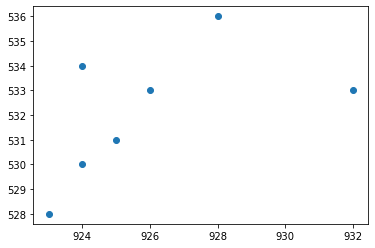

In [36]:
# Get array centers
RFcenters = np.zeros([NCv,2], dtype=np.int64) - 1
for cc in range(NCv):
    k = glms[cc].get_weights()
    pfilt = np.sum(np.std(k, axis=3),axis=0).squeeze() # for colorRFs
    x,y = utils.max_multiD( pfilt )
    RFcenters[cc, :] = [x,y]   
#    pfilt = np.std(k, axis=2).squeeze()
#    x,y, snrs[cc] = CU.RFstd_evaluate( pfilt )
#    RFcenters[cc, :] = [x,y]

RFcenters[:,0] = RFcenters[:,0] + NFloc[0]
RFcenters[:,1] = RFcenters[:,1] + NFloc[1]
plt.plot(RFcenters[:, 0], RFcenters[:, 1],'o')
plt.show()

In [37]:
# Generate full GLM model like full drift model
glm_layer = Tlayer.layer_dict( 
    input_dims=[3,NXglm,NXglm,1], num_filters=NCv, bias=False, num_lags=num_lags,
    NLtype='lin', initialize_center = True)
glm_layer['reg_vals'] = {'d2xt': XTreg, 'l1': L1reg, 'glocalx': GLreg,'edge_t':100} 

stim_net =  FFnetwork.ffnet_dict( xstim_n='stim', layer_list=[glm_layer] )

drift_pars = NDNLayer.layer_dict( 
    input_dims=[1,1,1,NA], num_filters=NCv, bias=False, norm_type=0, NLtype='lin')
drift_pars['reg_vals'] = {'d2t': Dreg, 'bcs':{'d2t':0} } 

drift_net =  FFnetwork.ffnet_dict( xstim_n = 'Xdrift', layer_list=[drift_pars] )

comb_layer = ChannelLayer.layer_dict( num_filters=NCv, NLtype='softplus', bias=True )
comb_layer['weights_initializer'] = 'ones'

net_comb = FFnetwork.ffnet_dict( 
    xstim_n = None, ffnet_n=[0,1],
    layer_list = [comb_layer], ffnet_type='add')

glm_all = NDN.NDN(  
            ffnet_list = [stim_net, drift_net, net_comb], loss_type='poisson')

for cc in range(NCv):
    glm_all.networks[0].layers[0].weight.data[:, cc] = deepcopy(glms[cc].networks[0].layers[0].weight.data[:,0])
    glm_all.networks[1].layers[0].weight.data[:, cc] = deepcopy(glms[cc].networks[1].layers[0].weight.data[:,0])
    glm_all.networks[-1].layers[0].bias.data[cc] = deepcopy(glms[cc].networks[-1].layers[0].bias.data)

data.set_cells(valNF)
LLsCHECK = glm_all.eval_models(data[data.val_blks], null_adjusted=False) 
print(np.mean(LLsNULL-LLsR[:,1]), np.mean(LLsNULL-LLsCHECK))

Output set to 7 cells
0.00750143187386649 0.007501397814069476


In [38]:
LLsGLM = LLsNULL-LLsR[:,1]
sio.savemat(datadir2+PROOT+'_NF_GLM_info.mat', {
    'LLsNULL':LLsNULL[:,None], 'LLsGLM':LLsGLM[:, None], 'Dreg': Dreg,
    'RFcenters': RFcenters, 'top_corner': NFloc, 'valNF':valNF, 'NX': UNX})
sio.savemat(datadir2+PROOT+'_NF_stimpos.mat', {
    'LLsNULL':LLsNULL[:,None], 'LLsGLM':LLsGLM[:, None], 'drift_terms': drift_terms, 'Dreg': Dreg,
    'RFcenters': RFcenters, 'top_corner': NFloc, 'valUT':valUT, 'NX': UNX, 'source':'glms'})
drift_pop.save_model(filename=moddir+'NF_drift_pop.pkl')
glm_all.save_model(filename=moddir+'NF_GLM_pop.pkl')

for cc in range(NCv):
    glms[cc].save_model(
        filename=moddir+'NFglm' + utils.filename_num2str(cc, num_digits=3) + '_iter0.pkl')

  Saving model at /Data/FelixData/Conway/proc/J220711/models/NF_drift_pop.pkl
  Saving model at /Data/FelixData/Conway/proc/J220711/models/NF_GLM_pop.pkl
  Saving model at /Data/FelixData/Conway/proc/J220711/models/NFglm000_iter0.pkl
  Saving model at /Data/FelixData/Conway/proc/J220711/models/NFglm001_iter0.pkl
  Saving model at /Data/FelixData/Conway/proc/J220711/models/NFglm002_iter0.pkl
  Saving model at /Data/FelixData/Conway/proc/J220711/models/NFglm003_iter0.pkl
  Saving model at /Data/FelixData/Conway/proc/J220711/models/NFglm004_iter0.pkl
  Saving model at /Data/FelixData/Conway/proc/J220711/models/NFglm005_iter0.pkl
  Saving model at /Data/FelixData/Conway/proc/J220711/models/NFglm006_iter0.pkl


In [39]:
glm_ks = np.zeros([NCv, 3, NXglm, NXglm, num_lags]) 
for cc in range(NCv):
    glm_ks[cc,:,:,:,:] = glms[cc].get_weights().squeeze()
glm_ks.shape

(7, 3, 60, 60, 10)

In [40]:
sio.savemat(analdir+PROOT+'_NF_GLM_measures.mat', {
    'glm_ks':glm_ks, 'valNF':valNF, 'LLsGLM':LLsGLM[:, None], 'top_corner': NFloc,
    'RFcenters': RFcenters})

In [41]:
print('done!')

done!
